# Unsupervised Learning

## Clustering

Used to group data when you do not have a label to predict (seeing how similar/different things are from one another) or you are not predicting a label, but rather "condensing" data down to a fewer number of features.

For example, lets say we have a bunch of points plotted on a graph in the pattern below. We notice that it can be grouped into 3 different groups. If we add the encircled dot, it would be classified as part of the cyan group, since it is so "similar"

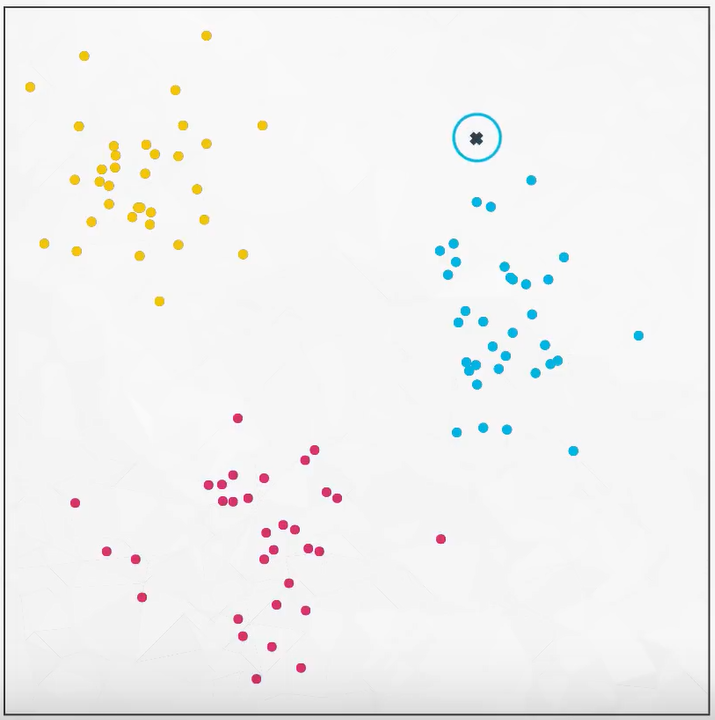

This is **clustering**, which is one of the types of unsup ML

### K-means algorithm

Used to cluster similar music, movies, books, etc. We can also cluster customers and such for generating recommendations.

"K" represents the number of clusters you have in the dataset.

For example, the graph below shows how far I travel and how awesome my day was. The first cluster is at work while the second is from visiting my mom.

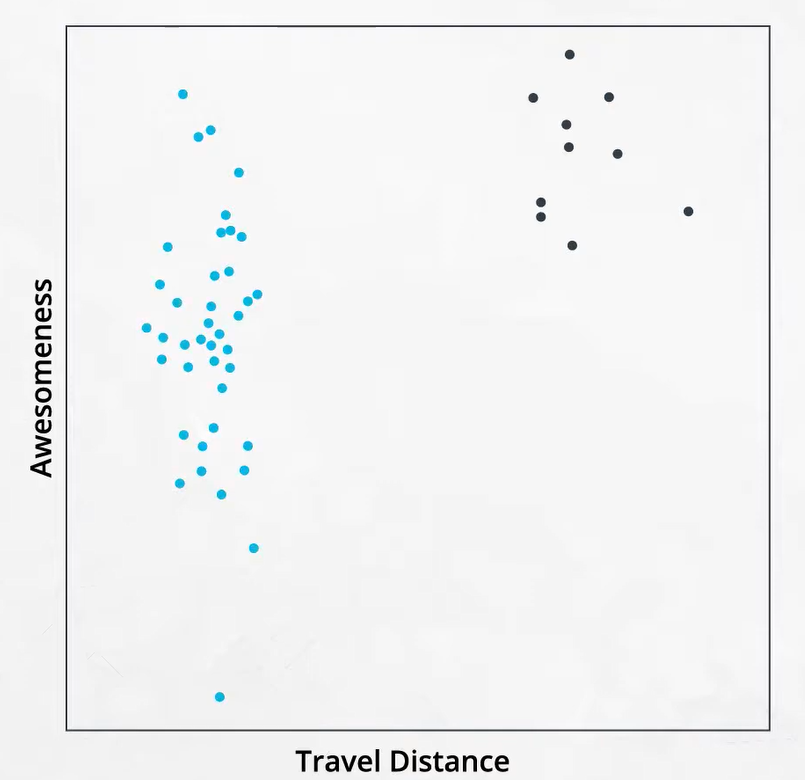

In this case, K is 2.

#### Changing/Choosing K

How many clusters you want to split your data into == K

Usually selected based on preconceived ideas about the topic.
- Example from Udacity - students using the material are either new to the skill, upskilling in their current career, or planning to make a change in career. This will be 3 clusters of students.

Some decision methods for choosing K are when you have no idea how many clusters the data has:
- Elbow method - kind of guess and check where you check an increasing number of clusters, taking the average distance of the points to the center of the cluster
  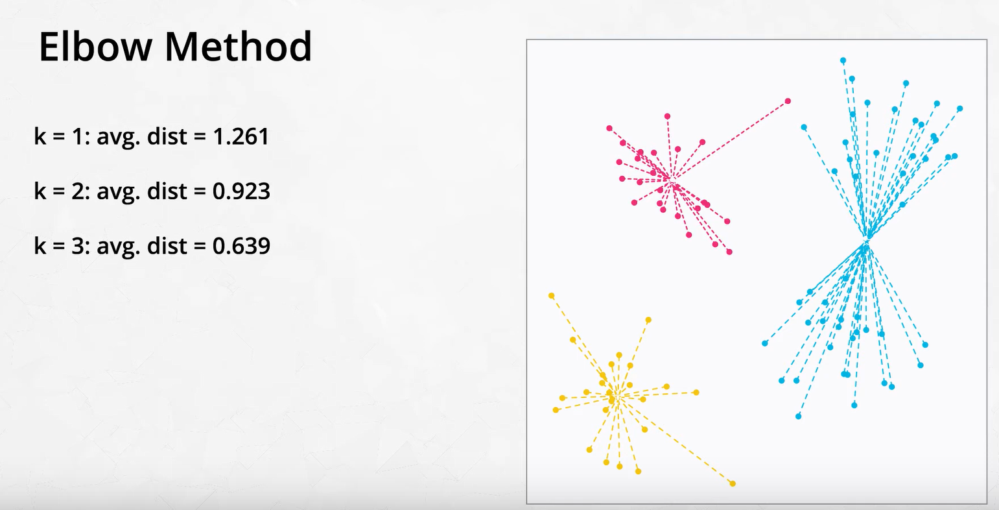
  - Plotting the results will graph a line like the one below
  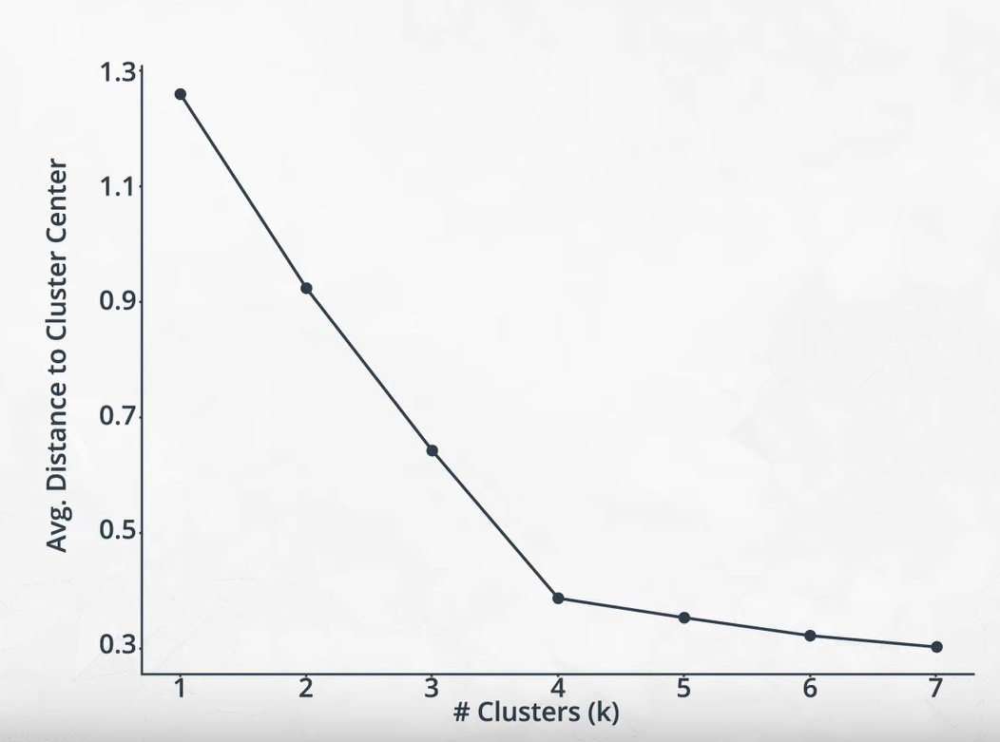
  - Now you take the elbow, or where it goes from sharp down to closer to the end.
  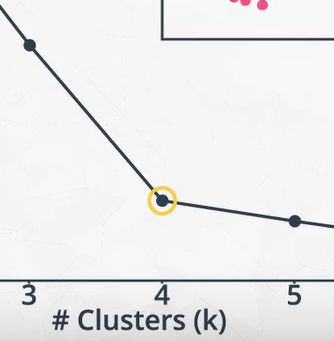
  - You want to get to a point where increasing K no longer significantly decreases the amount of light.

K will be the same number of centers/centroids in your model. This is a centroid (see image)

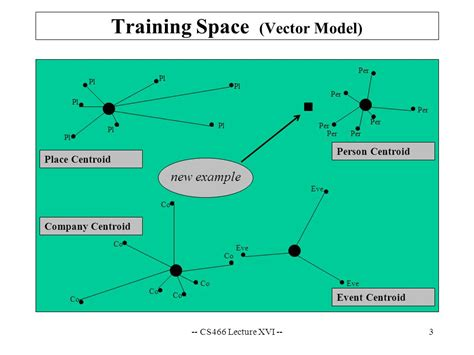

Once we have a dataset, the basic process for the K-means alg is (atleast when using `sklearn.cluster.KMeans`):
1. Instantiate the model (`km = KMeans(4)`)
2. Fit your model to the data (`model = km.fit(dataset)`)
3. Predict the labels for the data (`labels = model.predict(dataset)`)
4. Plot the data (example video shows `custom_helpers.plot_data(dataset, labels)`)

*Note: You can use `.predict_fit(dataset)` for doing steps 2 and 3 in one operation.*

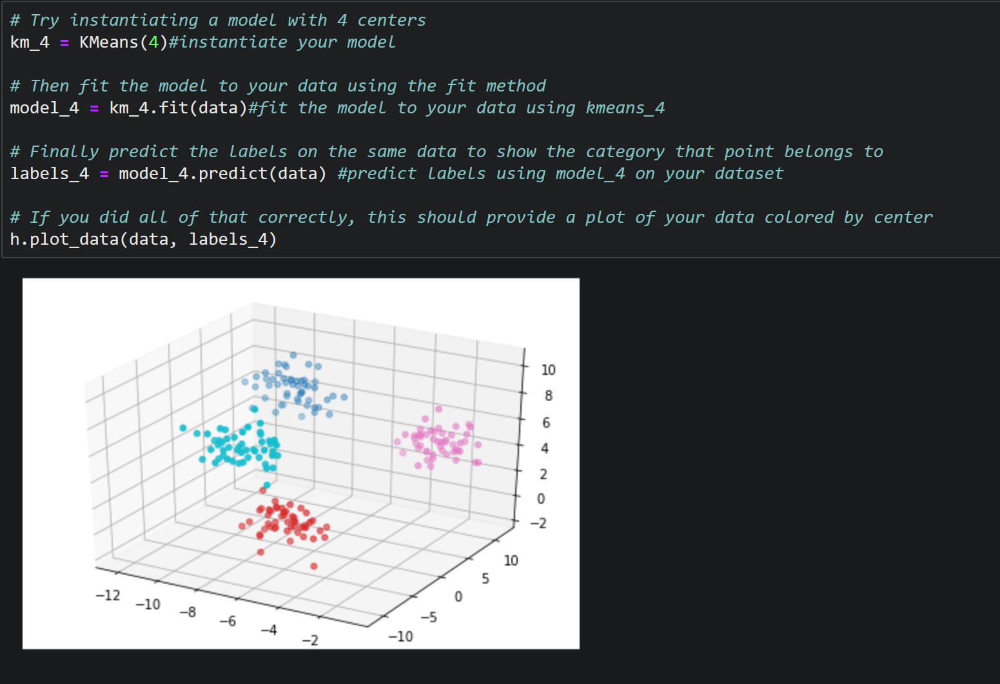

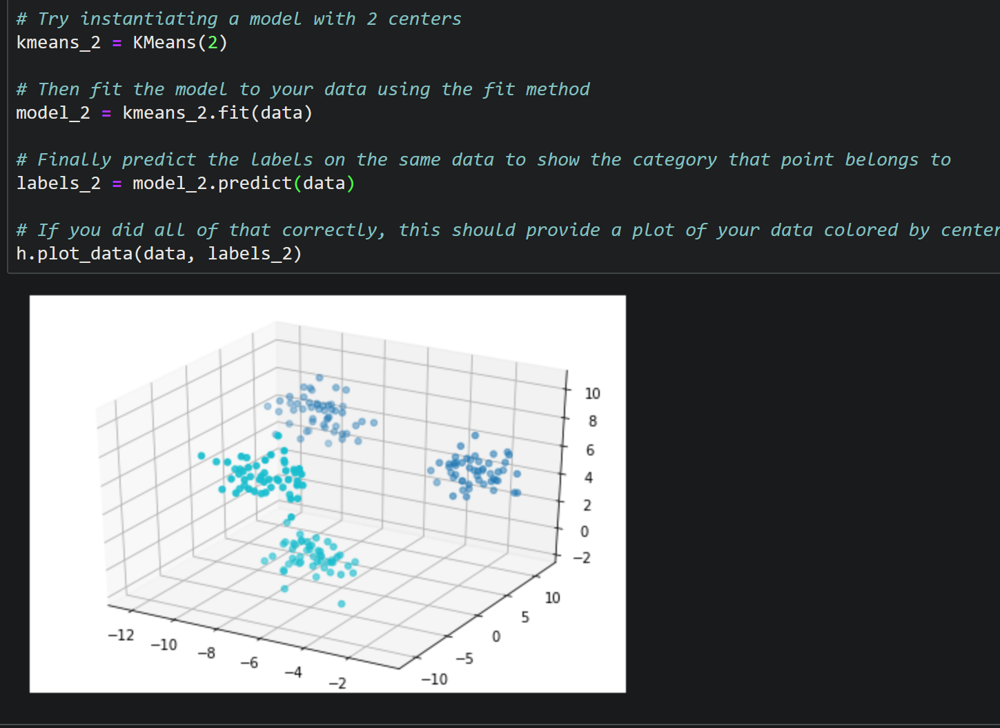

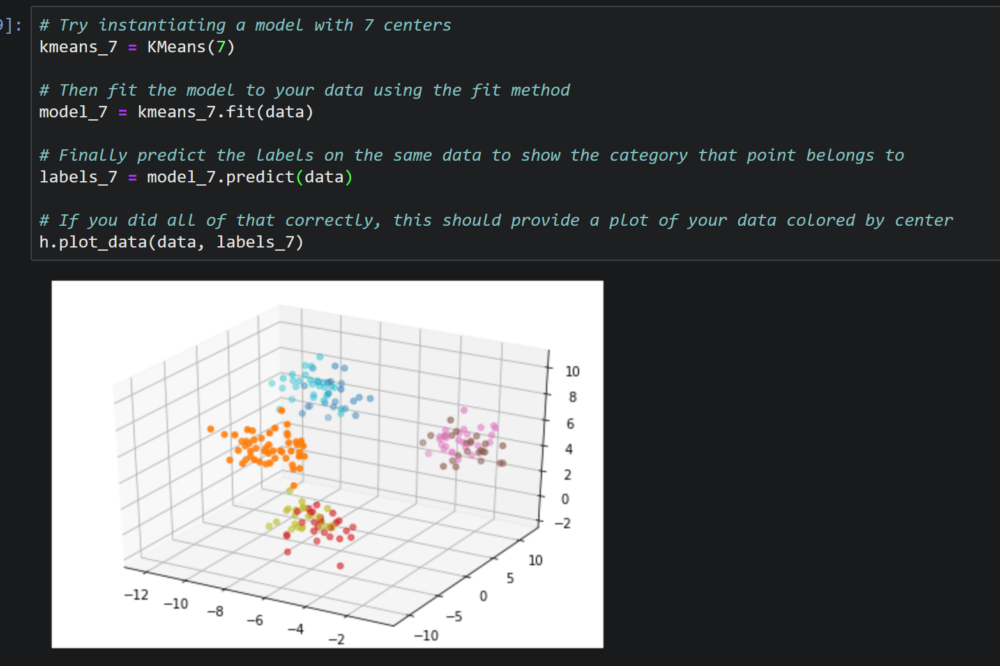

It's hard to tell what the best K value would be. One can imagine it would be 4 just based on the visualization, but we can also use some methods to **score** different K-vals.

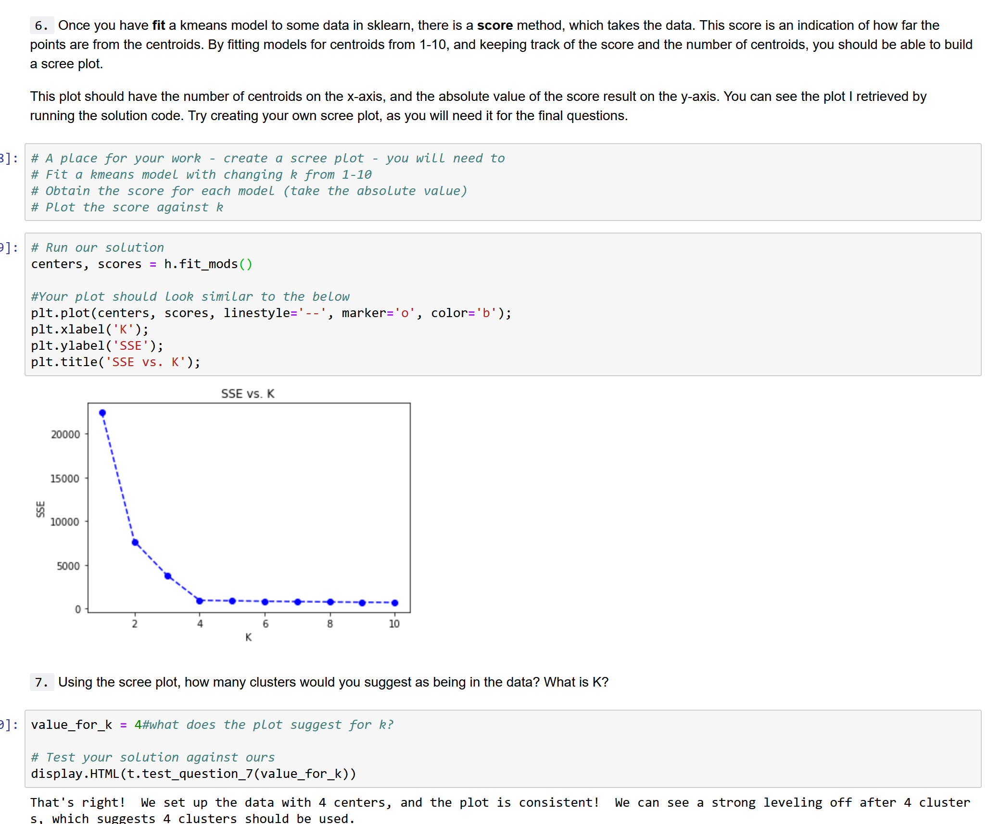

#### How does KMeans work?

1. Randomly place points on a graph of clustered points equal to the number that you are giving for K. These are known as centroids

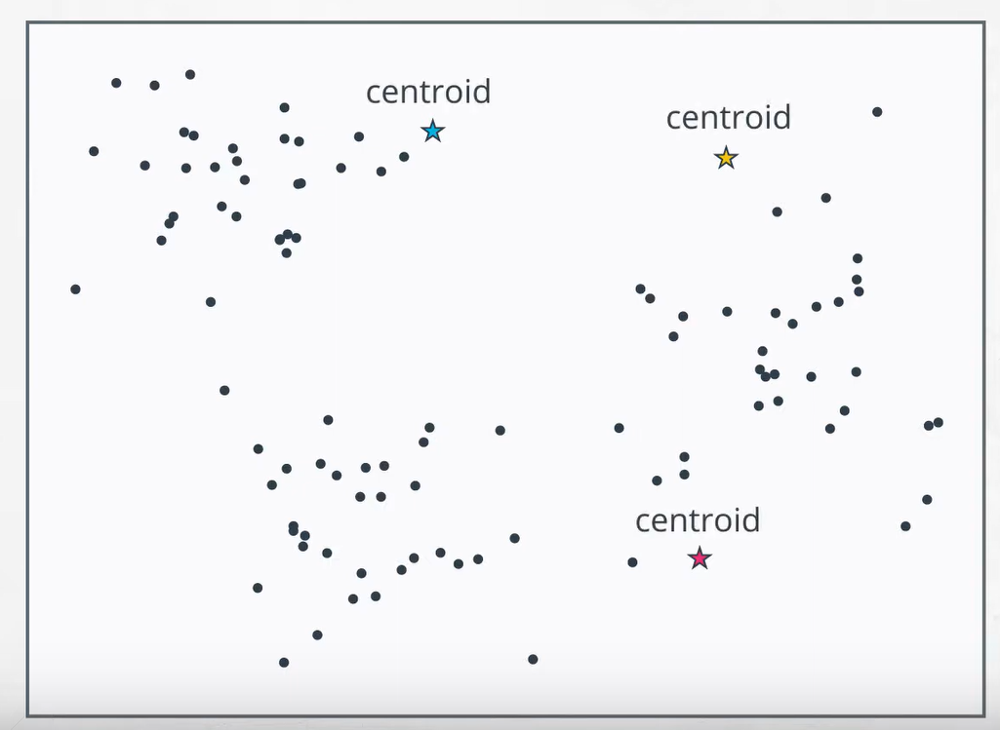

2. Assign the points in the data set to each centroid

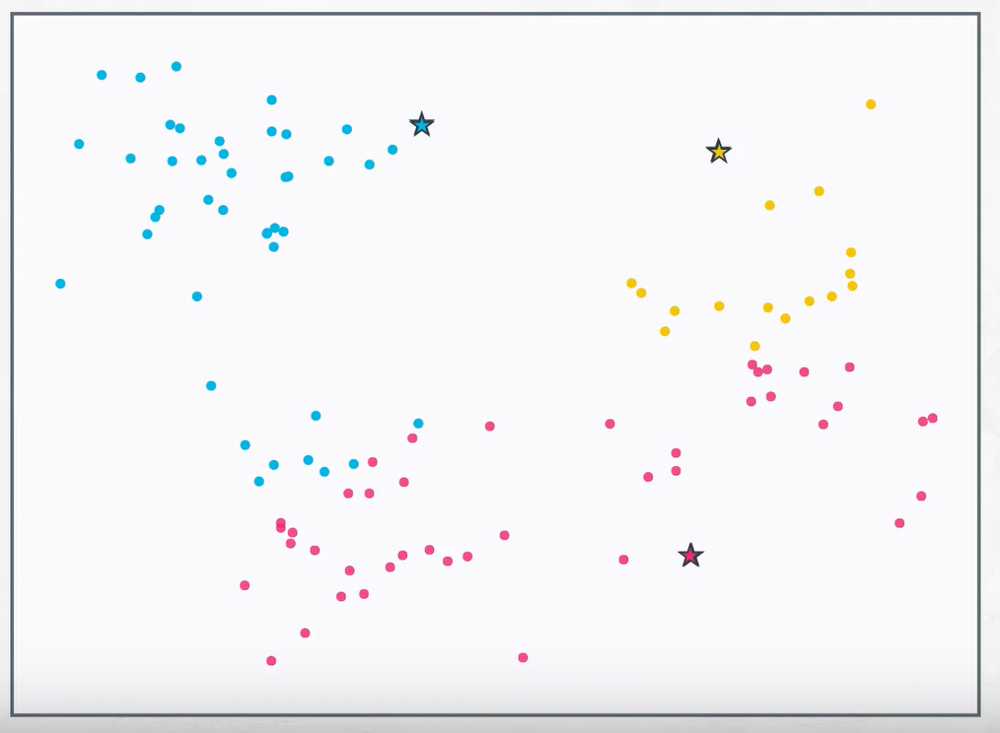

3. Move the centroid to the center of their assigned clusters

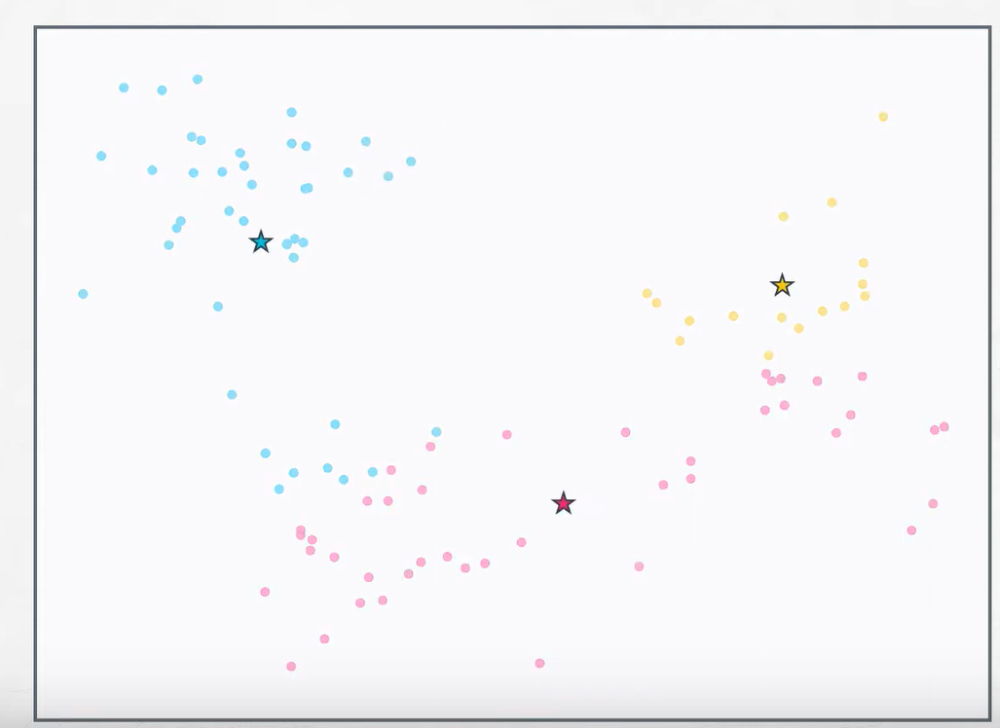

4. Points may now be closer to the centroid of a different group. Re-assign each point to the closest centroid once more.

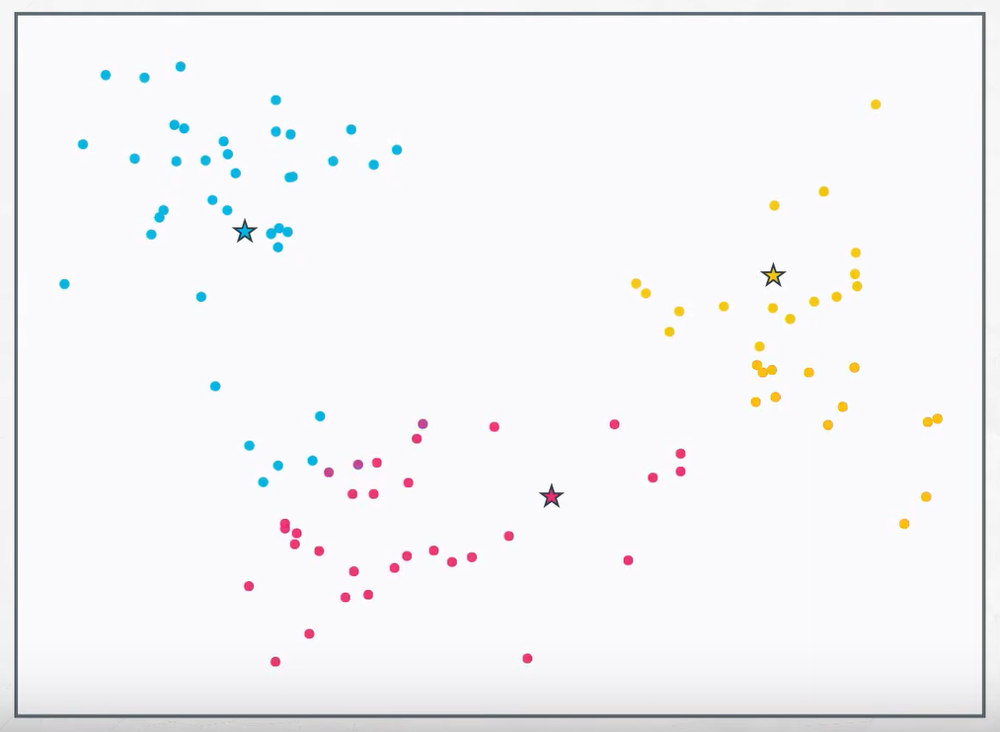

5. Repeat steps 3 and 4 until centroids will not move. That is the final result!

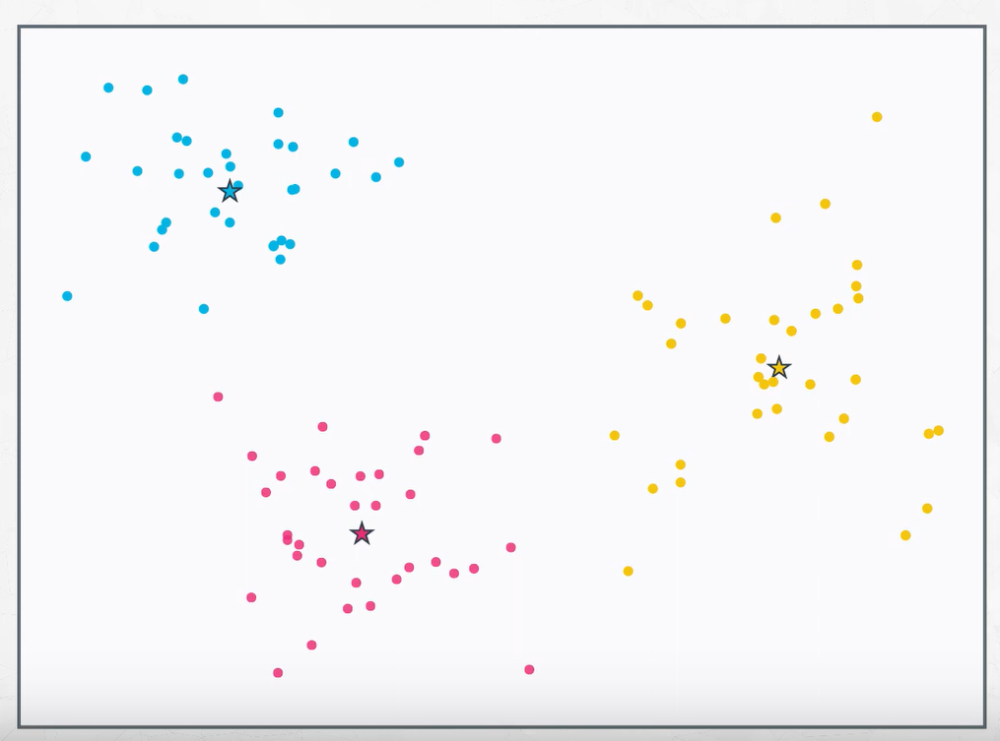





#### Further areas of concern

Can we be sure that final results of the clusters will be the same if the centroid is randomly placed?
- No

Does it matter where we place the centroid?
- Yes

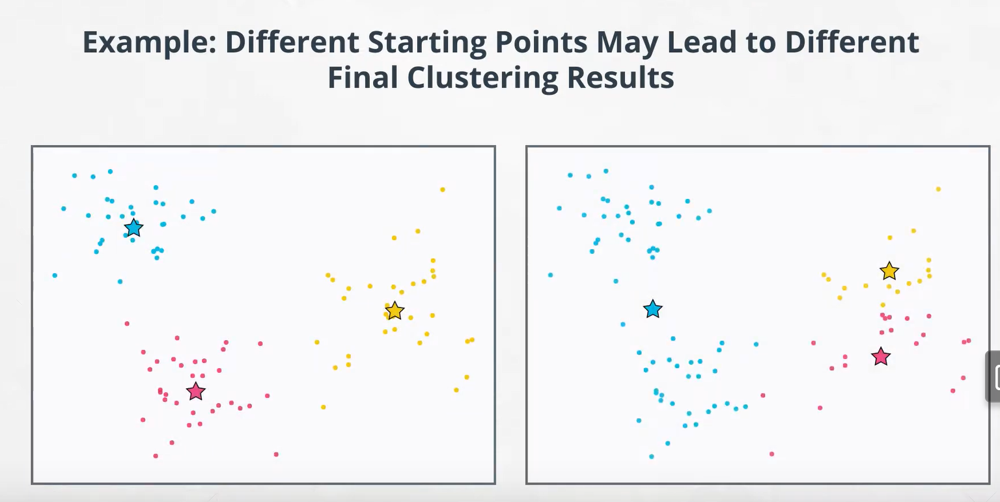

Scikit does this for you, but the best thing to do is to repeatedly run the KMeans alg. 
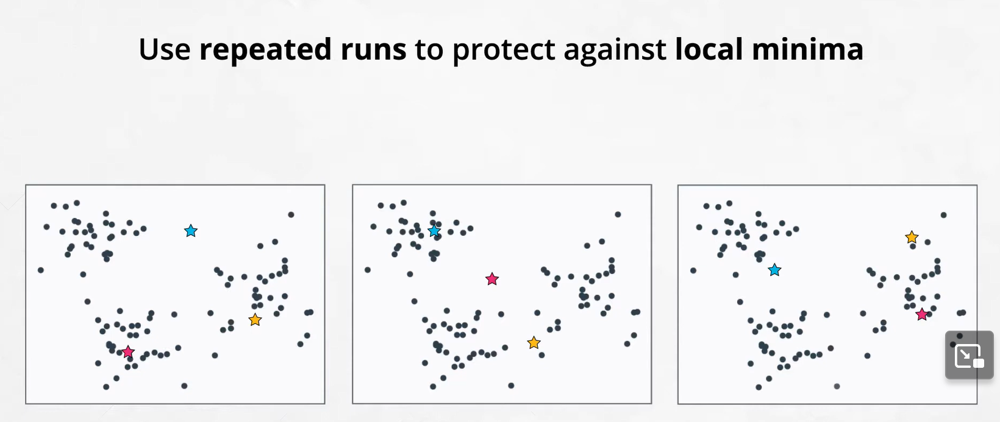

Groupings that differ when we choose different starting points from the multiple trials can be compared against the rest of the runs and each of their average distances between the points and the respective centroids.


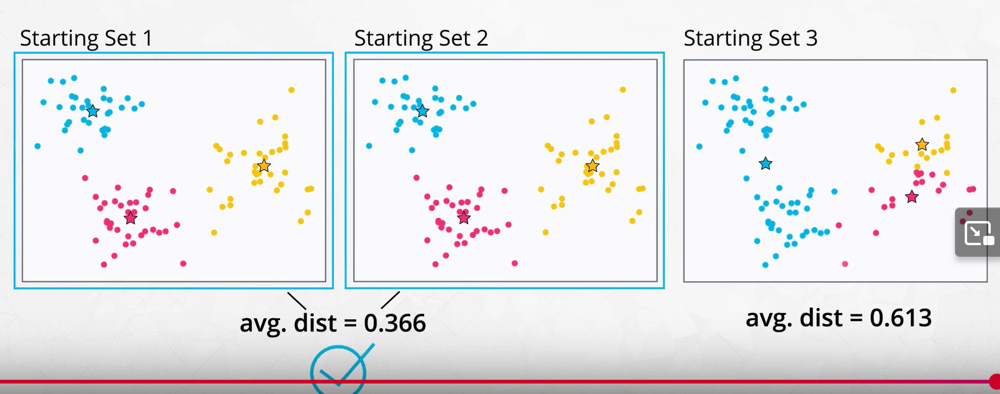

### Feature scaling

Necessary for using KMeans.

May choose to either do Standardizing (z-score scaling) or Normalizing (min-max scaling)

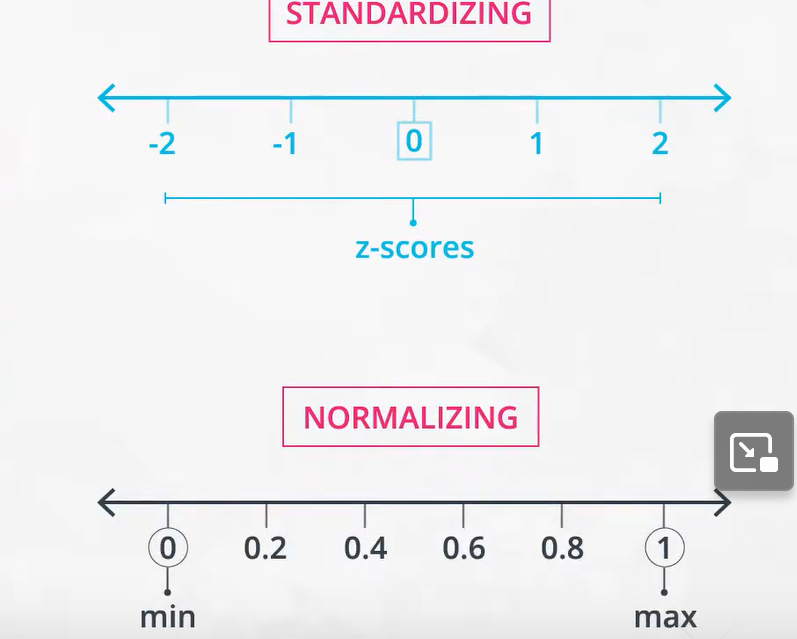

Usually we use standardizing with clustering algorithms

We use normalizing when scaling coloring of an image

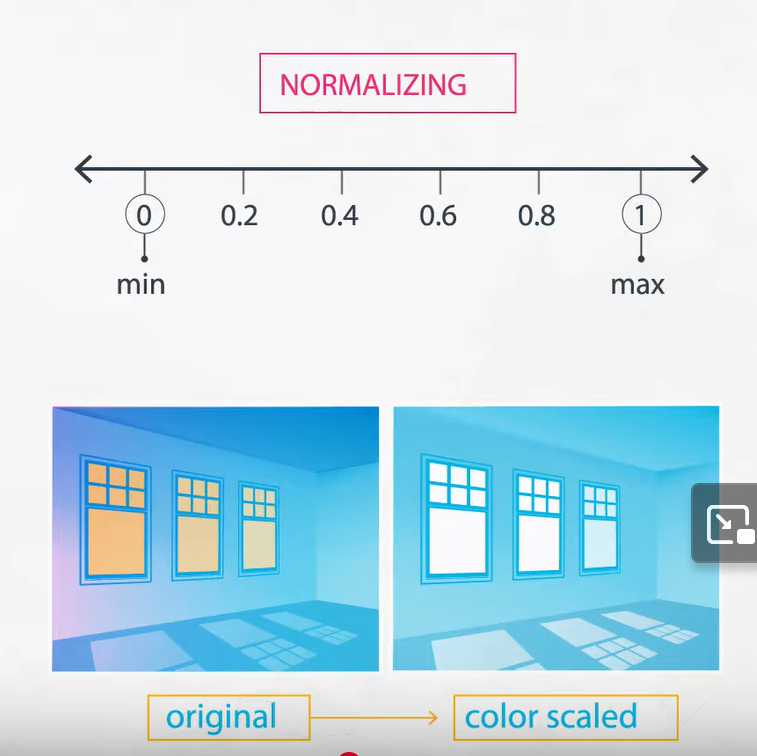

#### Feature Scaling Example


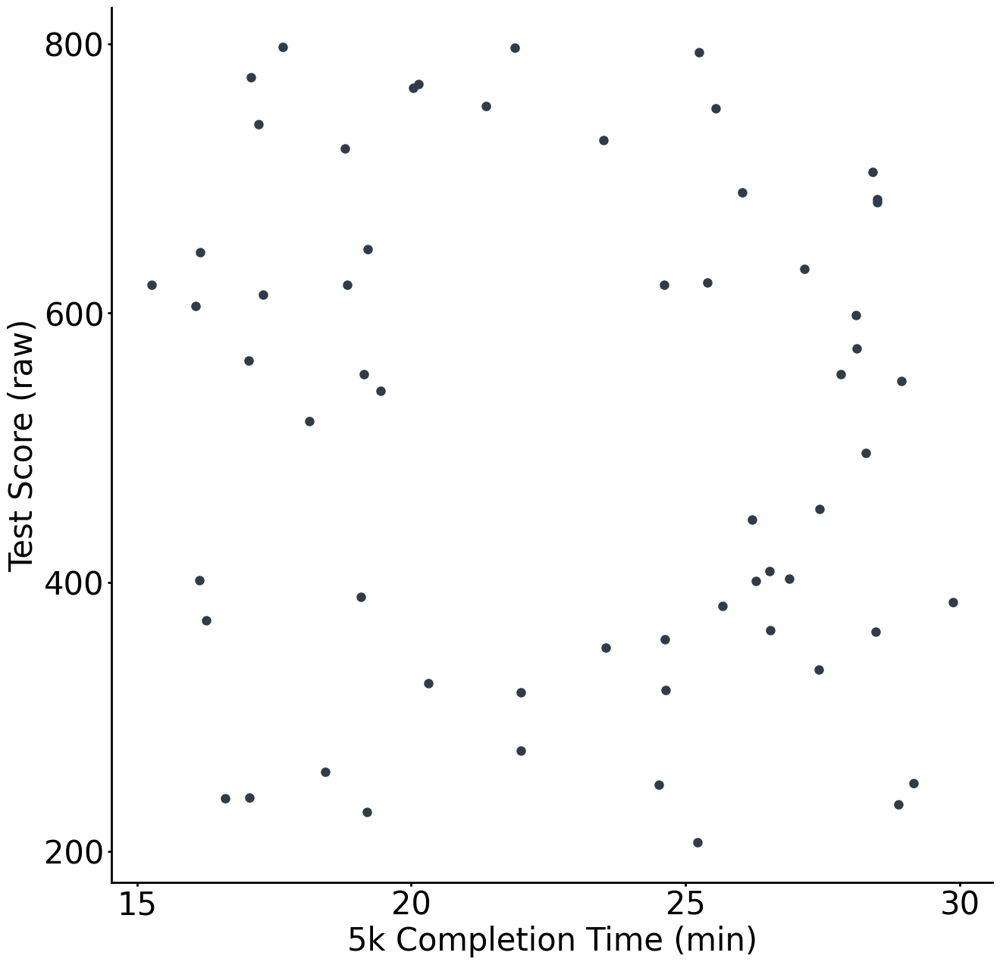

In [6]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.cluster import KMeans
from IPython.display import Image
from sklearn.datasets import make_blobs


%matplotlib inline

# DSND colors: UBlue, Salmon, Gold, Slate
plot_colors = ['#02b3e4', '#ee2e76', '#ffb613', '#2e3d49']

# Light colors: Blue light, Salmon light
plot_lcolors = ['#88d0f3', '#ed8ca1', '#fdd270']

# Gray/bg colors: Slate Dark, Gray, Silver
plot_grays = ['#1c262f', '#aebfd1', '#fafbfc']


def create_data():
    n_points = 120
    X = np.random.RandomState(3200000).uniform(-3, 3, [n_points, 2])
    X_abs = np.absolute(X)

    inner_ring_flag = np.logical_and(X_abs[:,0] < 1.2, X_abs[:,1] < 1.2)
    outer_ring_flag = X_abs.sum(axis = 1) > 5.3
    keep = np.logical_not(np.logical_or(inner_ring_flag, outer_ring_flag))

    X = X[keep]
    X = X[:60] # only keep first 100
    X1 = np.matmul(X, np.array([[2.5, 0], [0, 100]])) + np.array([22.5, 500])
    
    
    plt.figure(figsize = [15,15])

    plt.scatter(X1[:,0], X1[:,1], s = 64, c = plot_colors[-1])

    plt.xlabel('5k Completion Time (min)', size = 30)
    plt.xticks(np.arange(15, 30+5, 5), fontsize = 30)
    plt.ylabel('Test Score (raw)', size = 30)
    plt.yticks(np.arange(200, 800+200, 200), fontsize = 30)

    ax = plt.gca()
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    [side.set_linewidth(2) for side in ax.spines.values()]
    ax.tick_params(width = 2)
    plt.savefig('C18_FeatScalingEx_01.png', transparent = True)
    
    
    data = pd.DataFrame(X1)
    data.columns = ['5k_Time', 'Raw_Test_Score']
    
    return data

data = create_data()

In [7]:
data.describe()

,5k_Time,Raw_Test_Score
count,60.000000,60.000000
mean,22.899027,511.699603
std,4.536244,183.222427
min,15.263902,206.597283
25%,18.820638,361.798208
50%,24.033613,545.795365
75%,26.956643,656.346547
max,29.867819,797.599192


In [8]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 60 entries, 0 to 59
Data columns (total 2 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   5k_Time         60 non-null     float64
 1   Raw_Test_Score  60 non-null     float64
dtypes: float64(2)
memory usage: 1.1 KB


In [9]:
model = KMeans(2) # instantiate a model with two centers
preds = model.fit_predict(data) # fit and predict

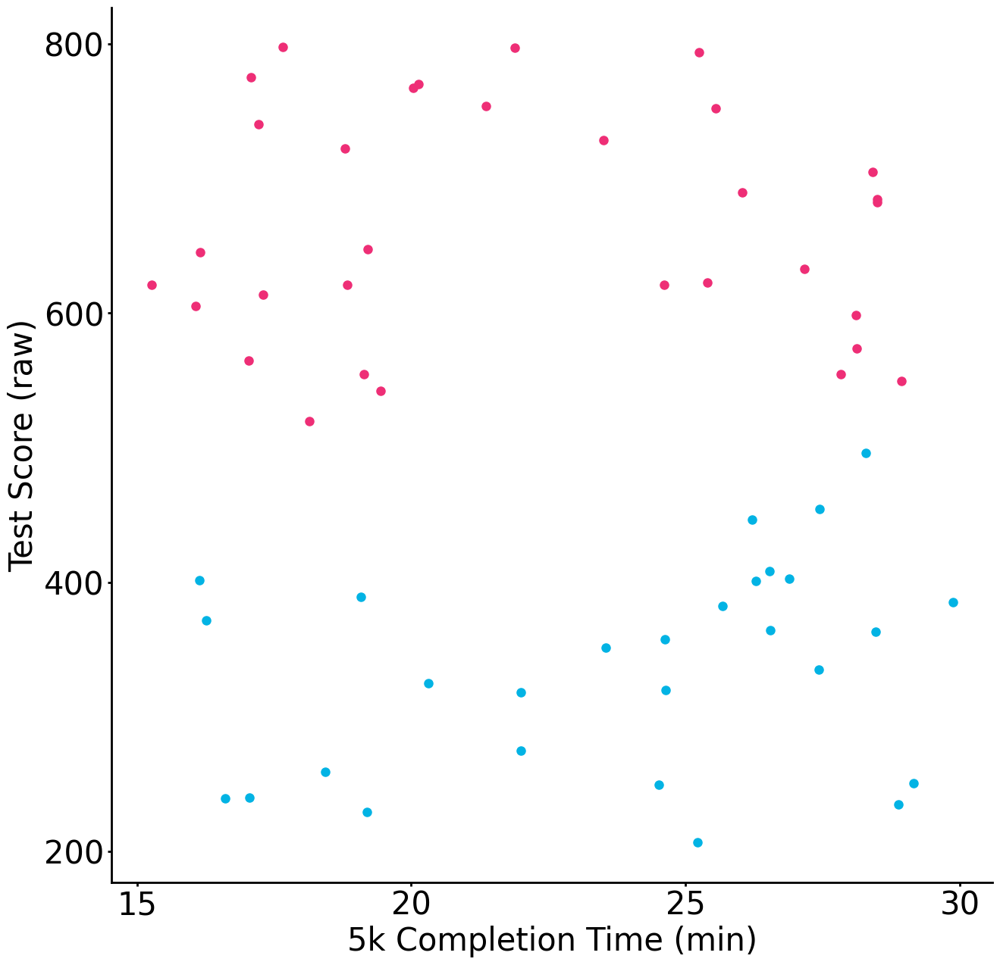

In [10]:
# Run this to see your results

def plot_clusters(data, preds, n_clusters):
    plt.figure(figsize = [15,15])

    for k, col in zip(range(n_clusters), plot_colors[:n_clusters]):
        my_members = (preds == k)
        plt.scatter(data['5k_Time'][my_members], data['Raw_Test_Score'][my_members], s = 64, c = col)

    plt.xlabel('5k Completion Time (min)', size = 30)
    plt.xticks(np.arange(15, 30+5, 5), fontsize = 30)
    plt.ylabel('Test Score (raw)', size = 30)
    plt.yticks(np.arange(200, 800+200, 200), fontsize = 30)

    ax = plt.gca()
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    [side.set_linewidth(2) for side in ax.spines.values()]
    ax.tick_params(width = 2)
    
plot_clusters(data, preds, 2)

Now lets standardize our results

In [17]:
data['test_scaled'] = (data['Raw_Test_Score'] - data['Raw_Test_Score'].mean()) / data['Raw_Test_Score'].std() # standardized test scores
data['5k_time_sec'] = data['5k_Time'] * 60 # times in seconds

In [20]:
model = KMeans(2) # instantiate a model with two centers
preds = model.fit_predict(data) # fit and predict

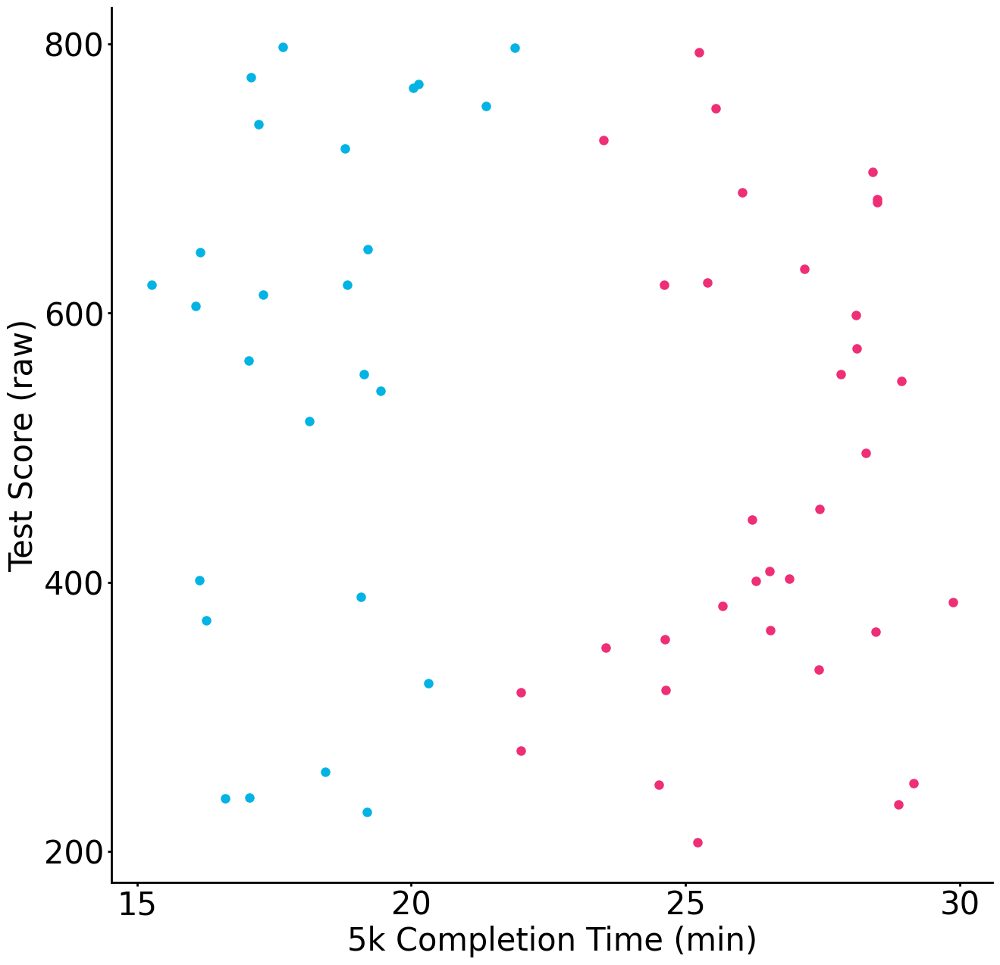

In [21]:
plot_clusters(data, preds, 2)

In [22]:
# options
a = 'We should always use normalizing'
b = 'We should always scale our variables between 0 and 1.'
c = 'Variable scale will frequently influence your results, so it is important to standardize for all of these algorithms.'
d = 'Scaling will not change the results of your output.'

best_option = c# best answer variable here

Below are some pictures that show another way to scale using the sklearn preprocessing module to do some standard and min-max scaling.

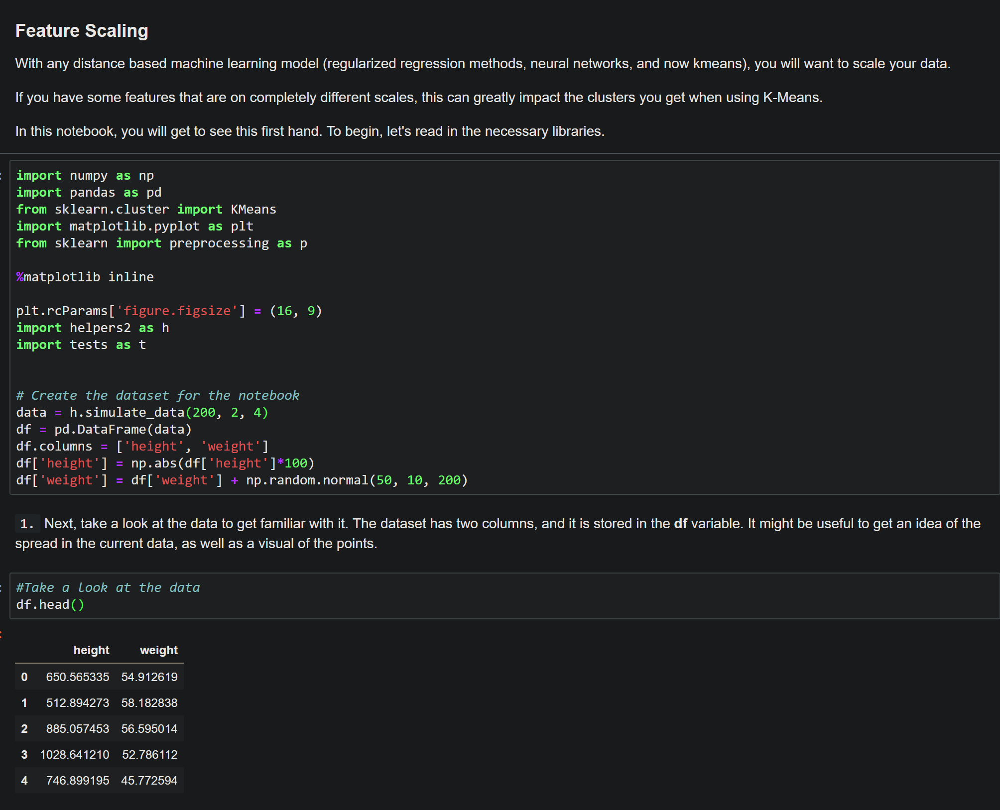

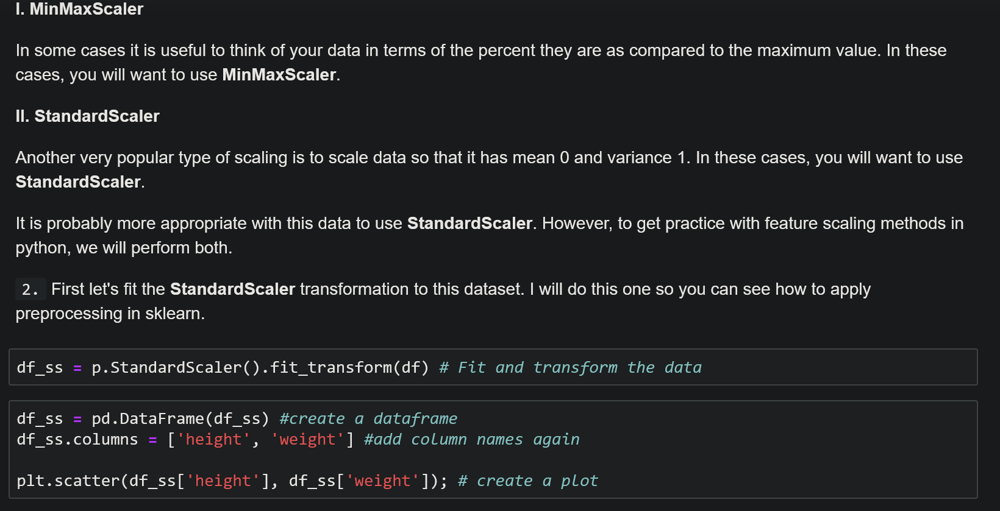

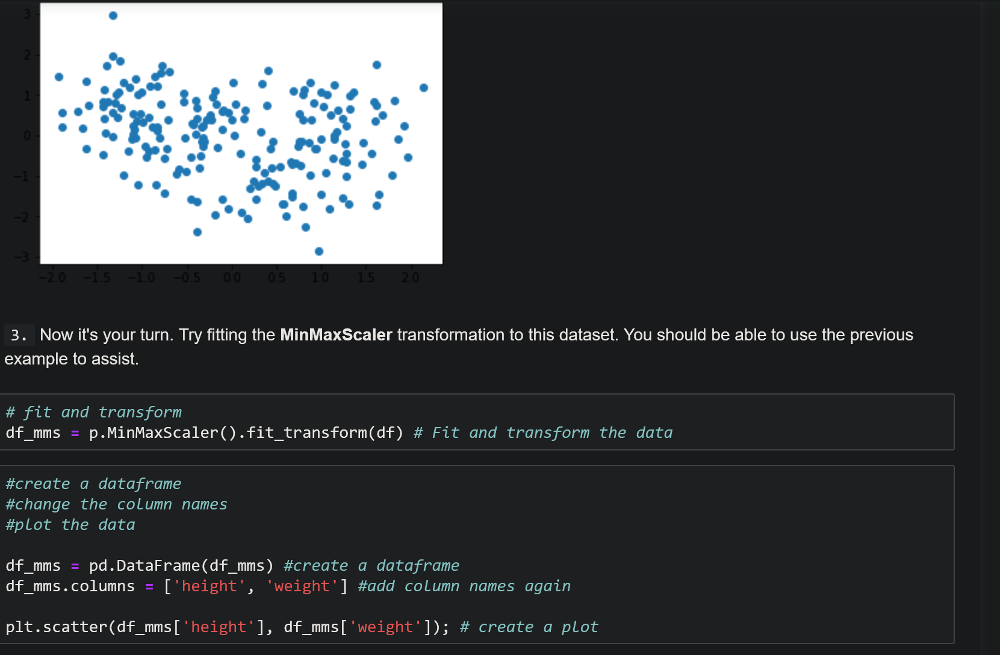

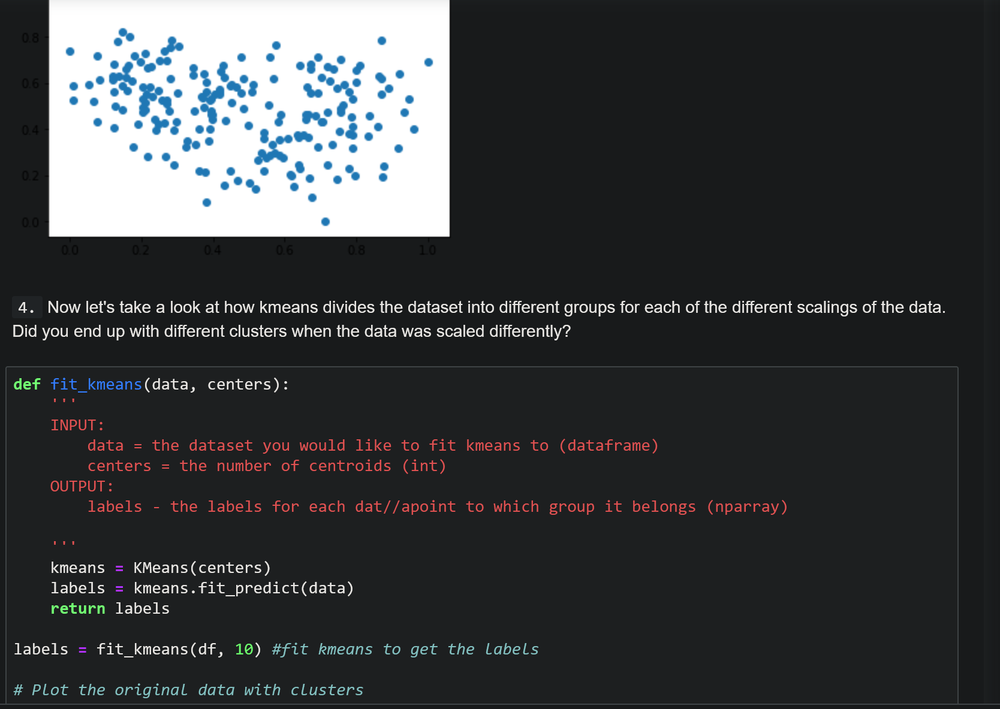

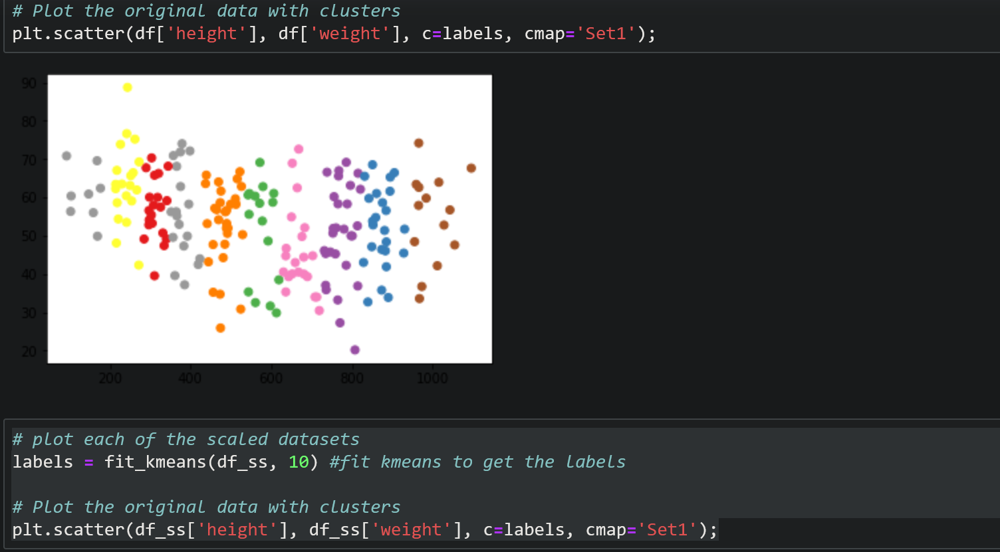

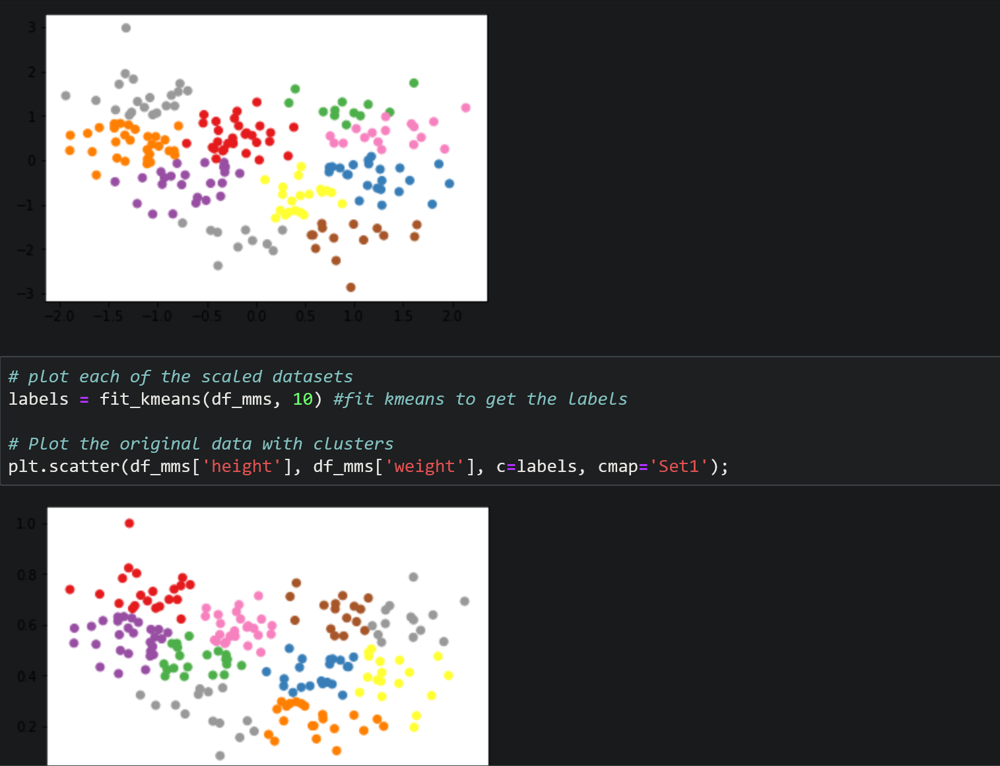

KMeans is really good for data that is like this

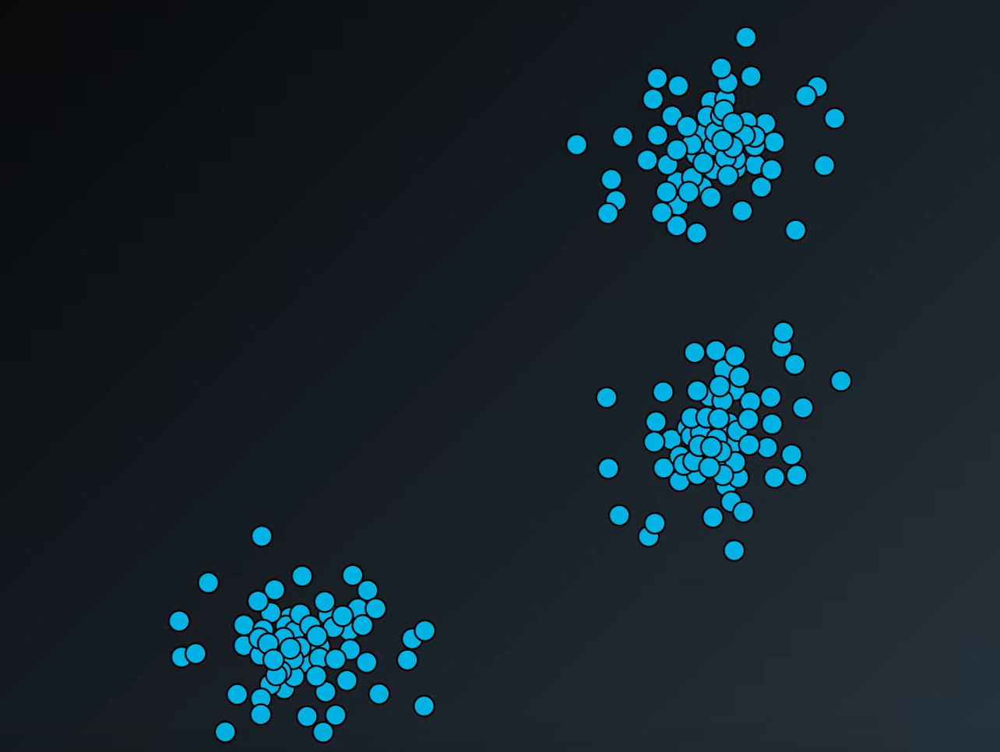

But data is like this is much harder to apply KMeans to.

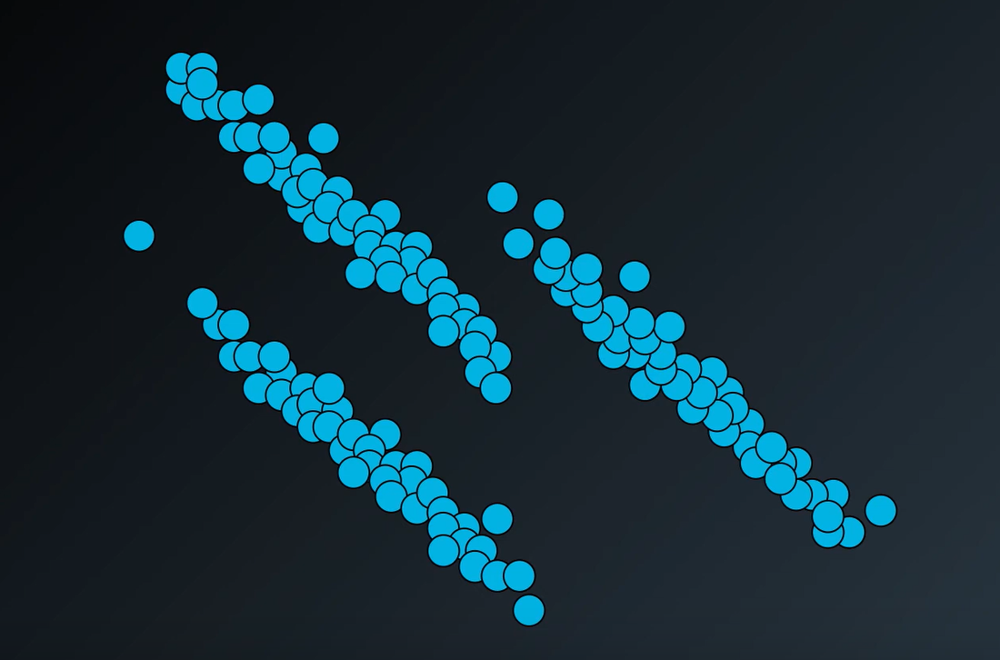

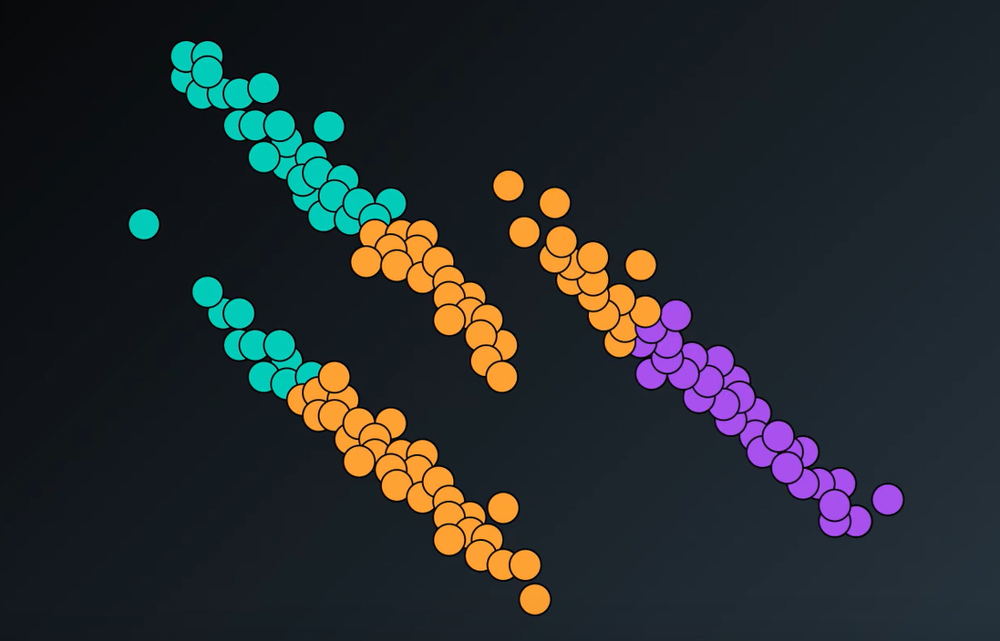

KMeans would give us something like the above, while we can intuitively pick out the different clusters

Inherently, due to caring about the distance from a centroid, Kmeans will be best when applied to clusters that are spherical in shape.

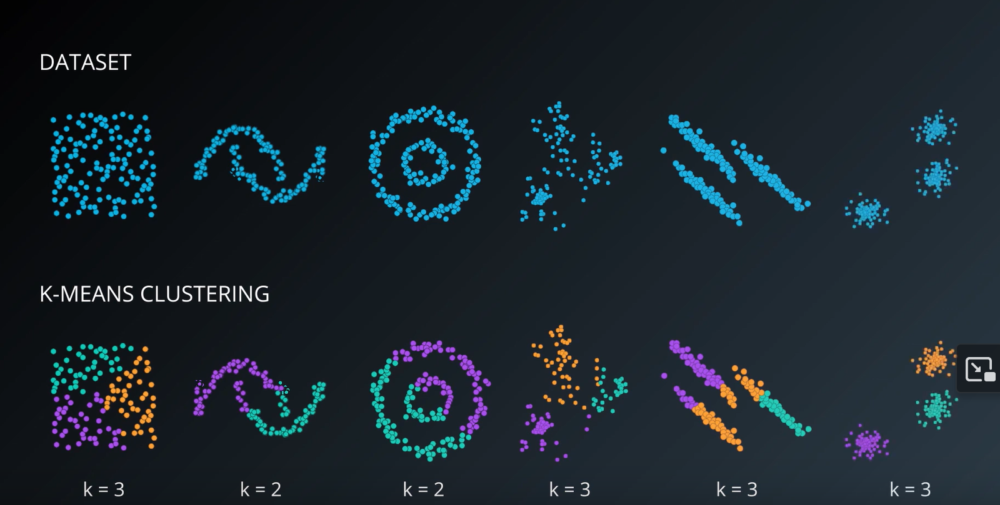

There are a few datasets that kmeans provides a reasonable solution to, like the first, second to last, and last.

## Hierarchical and Density Based Clustering (DBSCAN)

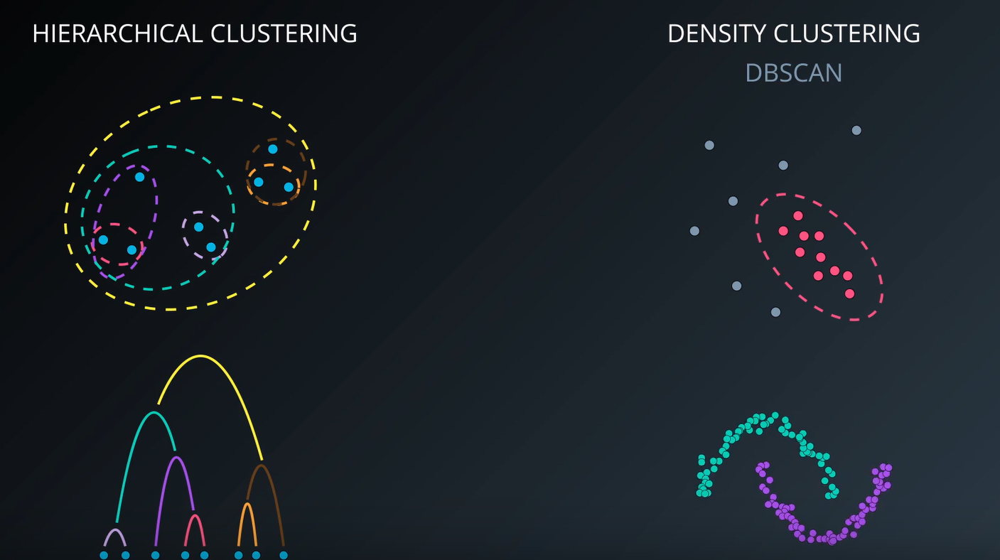

### Types of Hierarchical Clustering

#### Single-link clustering

- Choose smallest distance between two points and consider them a cluster

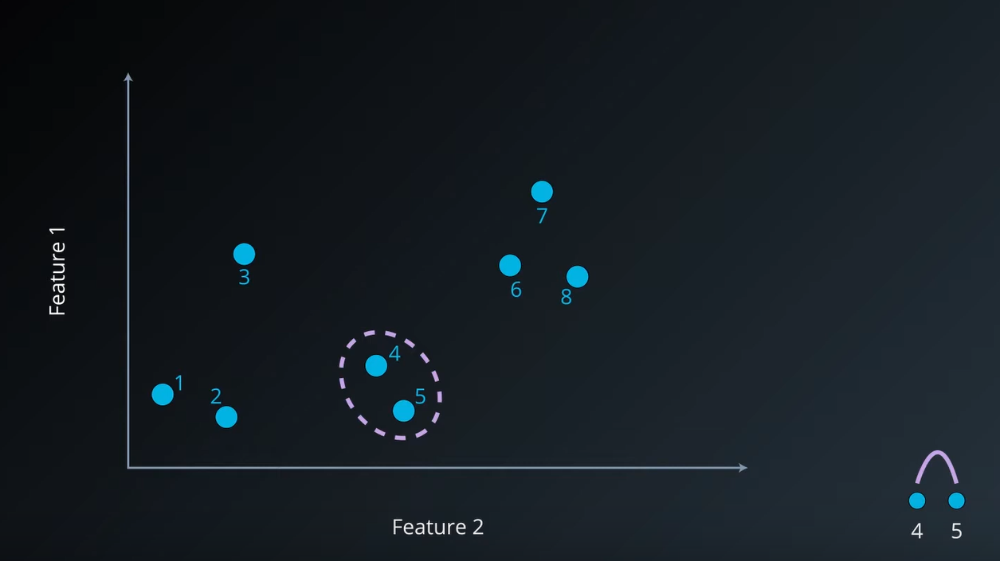

- Repeat that for each point.

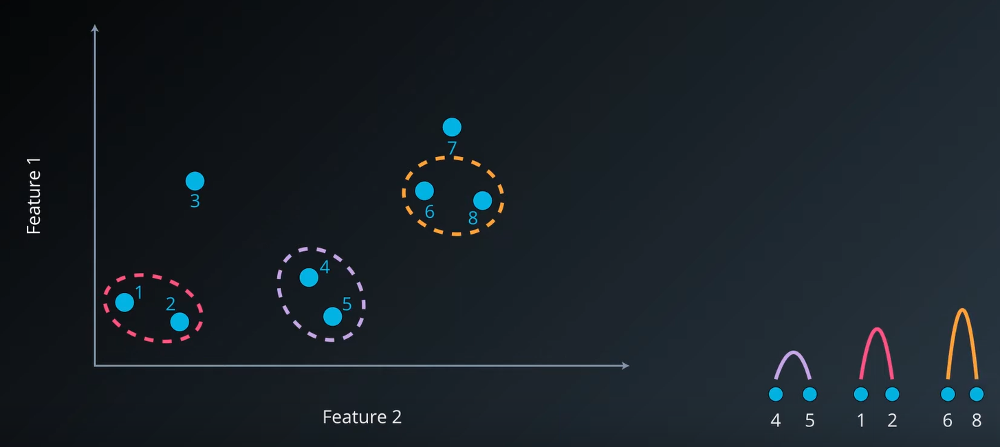

- What is the distance between point 7 and the cluster of 6 and 8?
  - With single-link clustering, we will take the closest point of the cluster to the target point.

  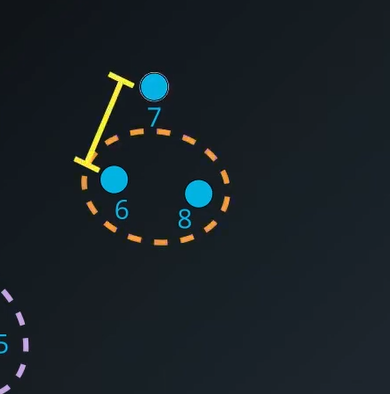

  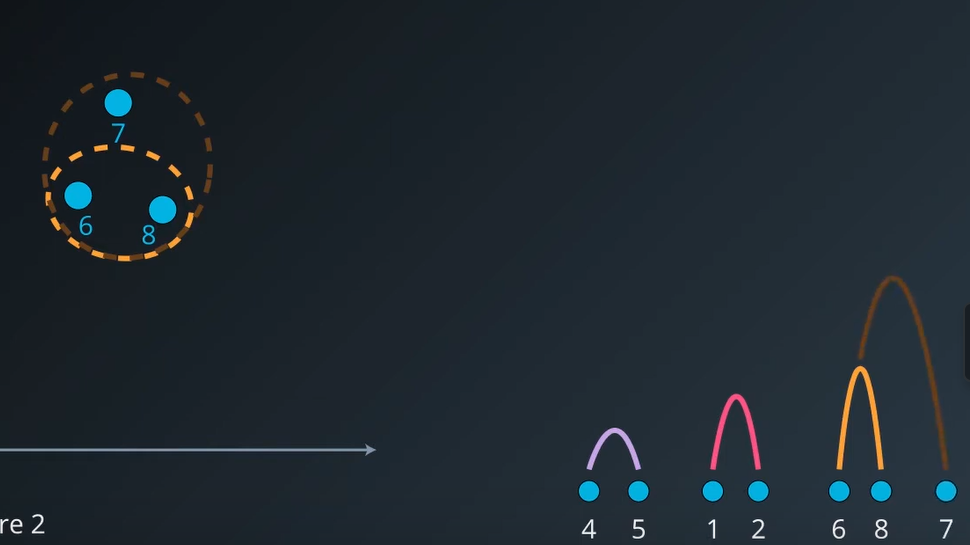

- Keep making a tree of sorts by repeating the process above for all points and clusters. This will make a **Dendrogram**

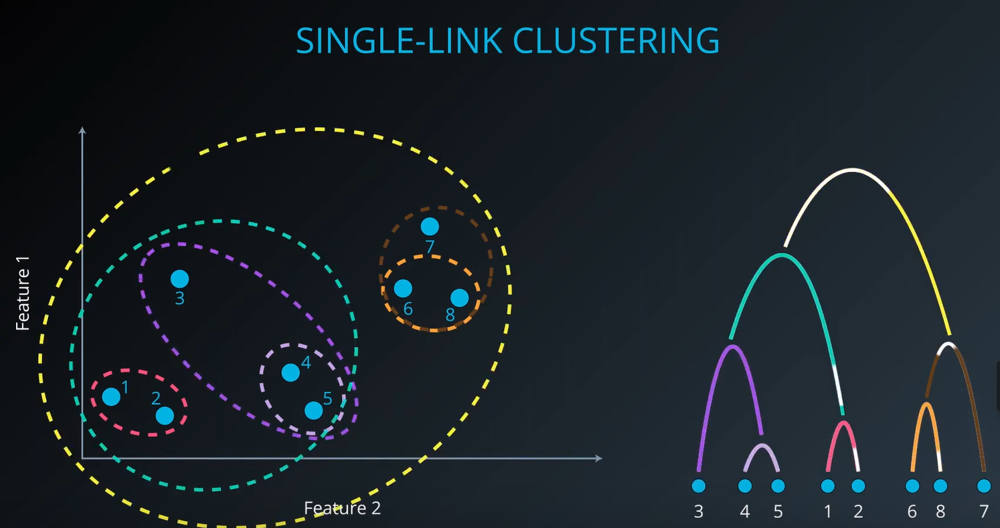

- Now we say how many clusters we want, then cut the tree to that level. Ex below shows us cutting the yellow and green clusters to get something with 3 clusters.

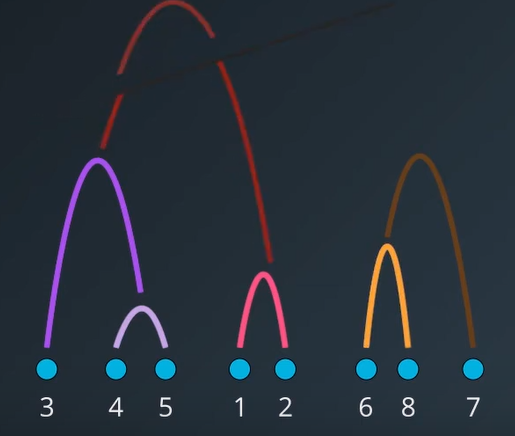



Because single-link just clusters based on the closest point, it may creat some pretty elongated/oblong clusters

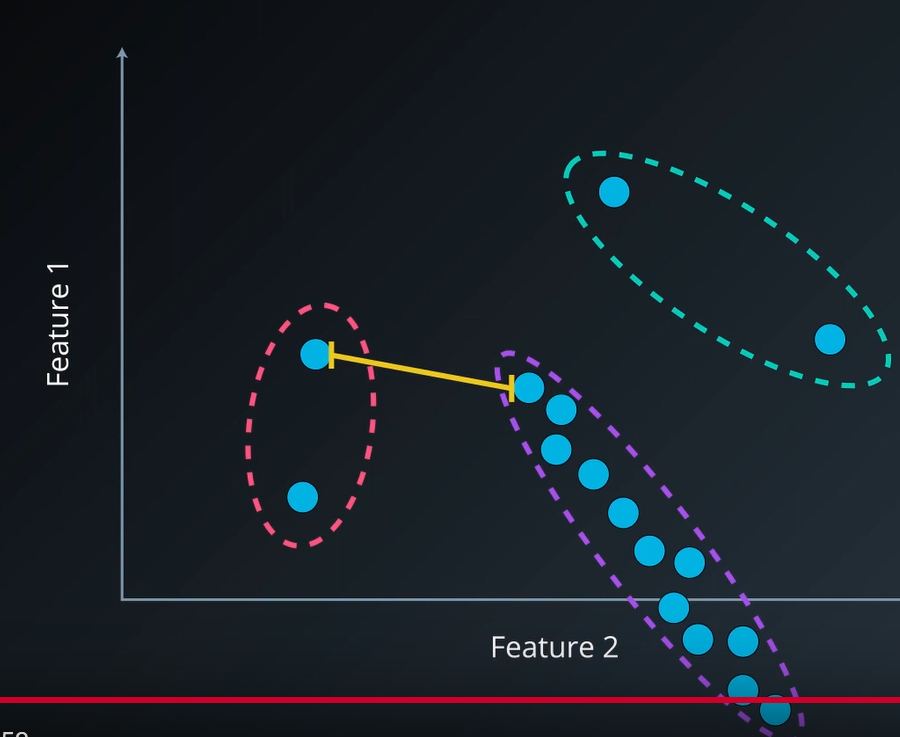

##### Examining Single-Link

Vs KMeans

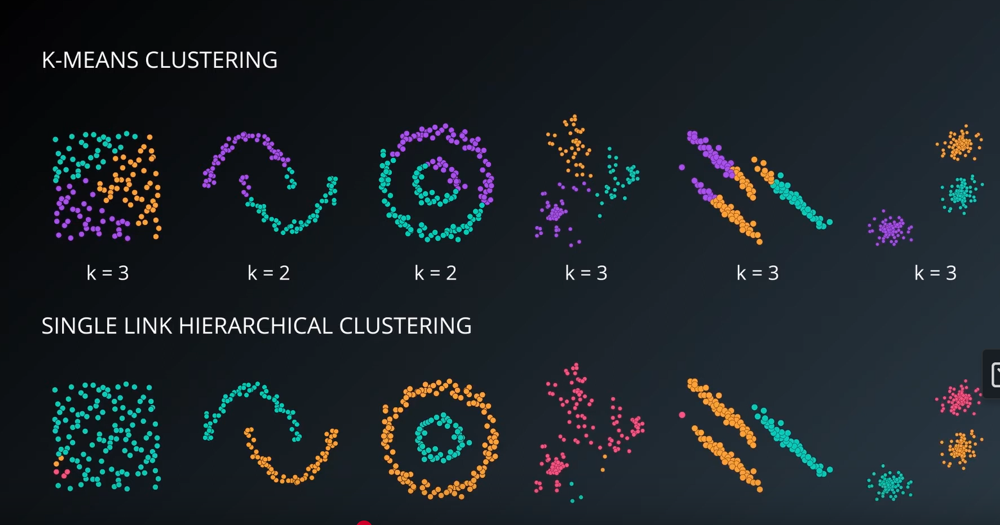

The handy thing with the dendrograms is that if we have more than 2 dimensions, it will essentially convert it into a 2D representation of the clustering relationship, which would be hard to visualize with a graphic otherwise.

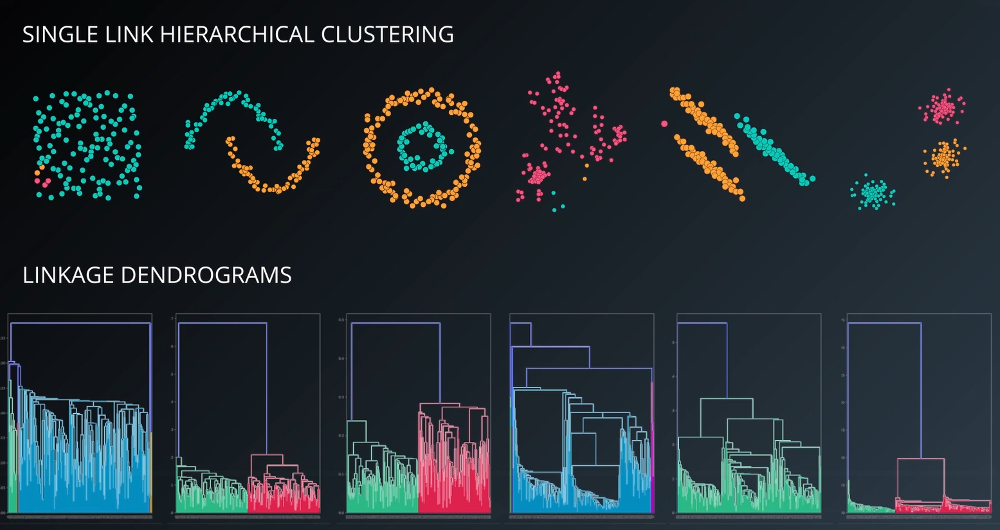

Btw, this is not in SKLearn

#### Complete-link clustering

Follows the same sequence as single-link:

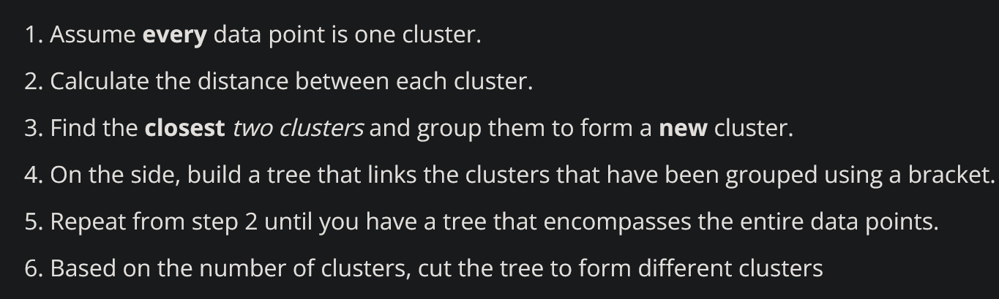

When calc'ing the distance, complete-link looks at the **farthest** two poins in the cluster (rather than nearest, so it's just the opposite.)

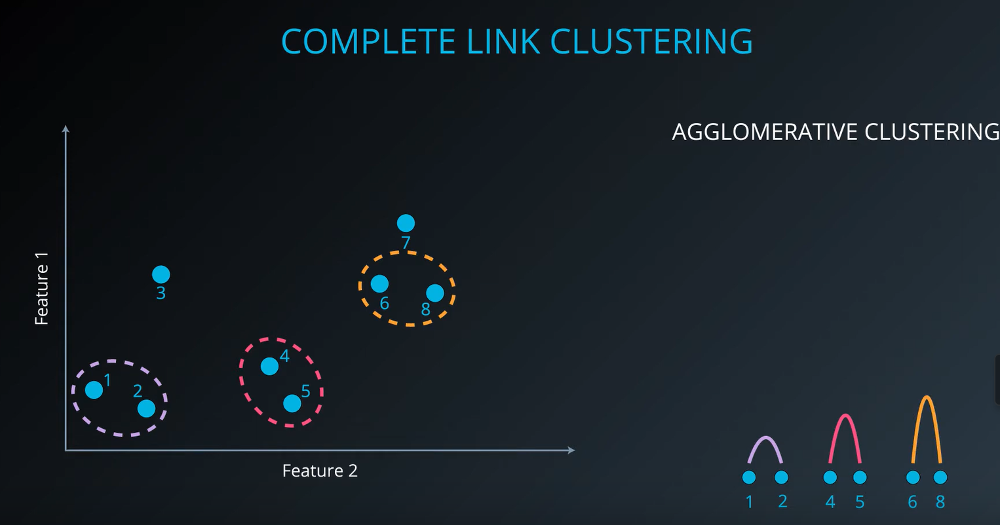

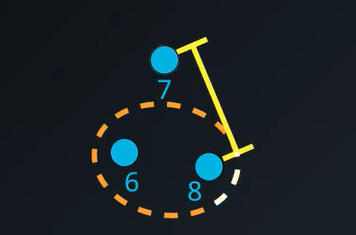

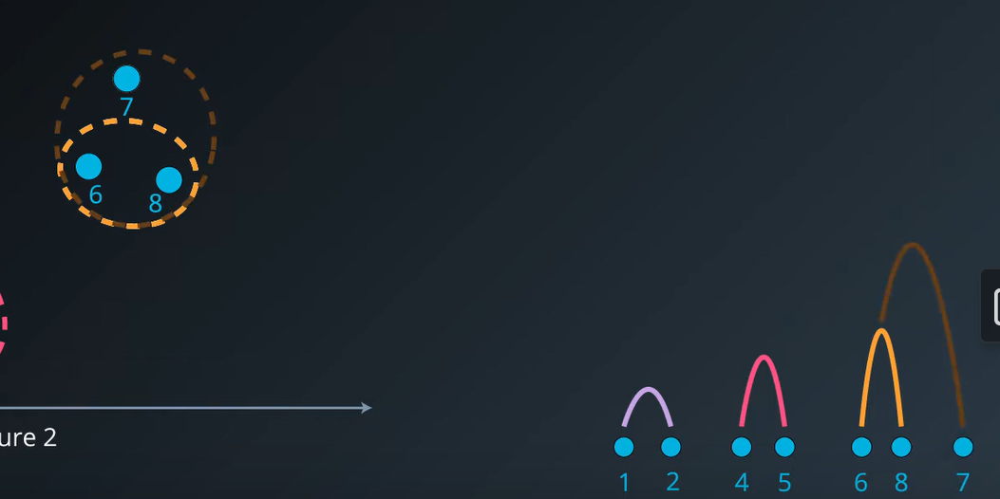

And then we can continue building it up until we have a single cluster, then cut it down until we have as many clusters as desired for the problem

Another little example

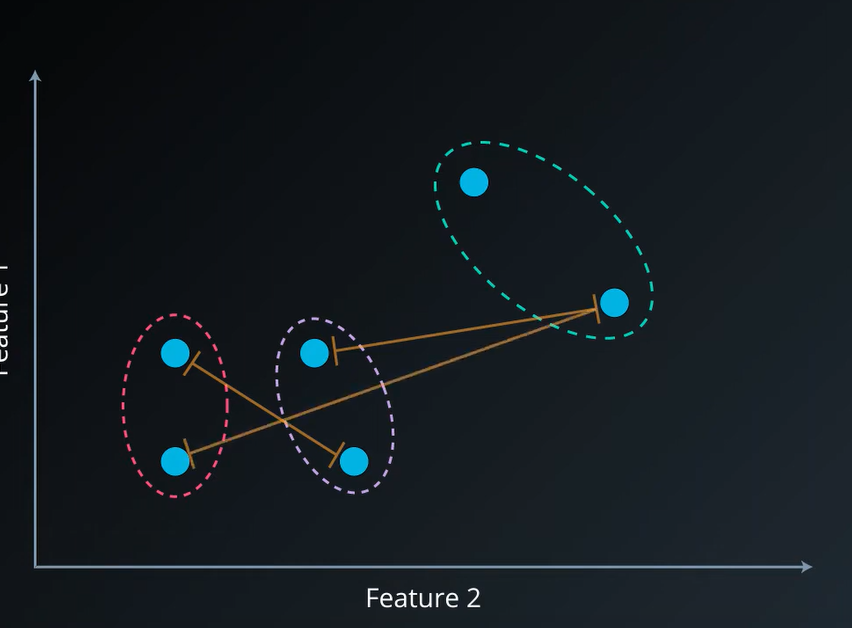


Produces **compact clusters**, but still only looking at one point. Remember, it looks at the farthest points to see which is closer

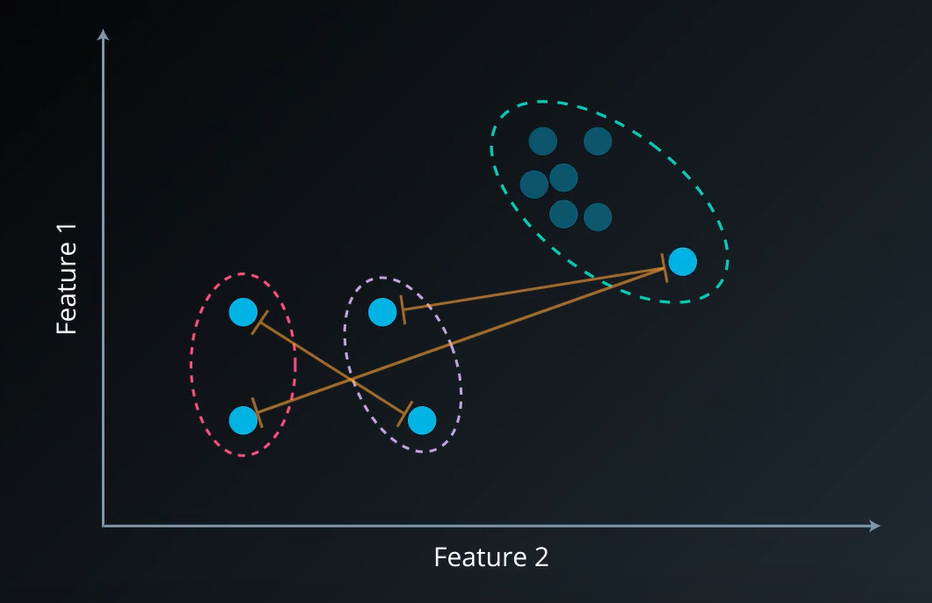

#### Average-link clustering

The same as single, but lookin at distance of every point to every other point in the other cluster, then averages it.

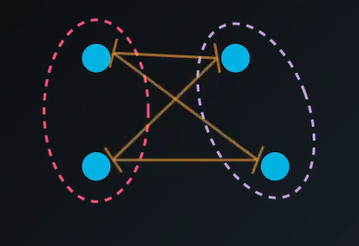

#### Ward's method

Default in SKLearn

Minimizes variance.by averaging the points to find the "center" and calc the distance between two clusters by doing

$$
\Delta(A,B) = C_{1}^2 + C_{2}^2 + C_{3}^2 + C_{4}^2 ... - A_{1}^2 - A_{2}^2... - B_{1}^2 - B_{2}^2...
$$

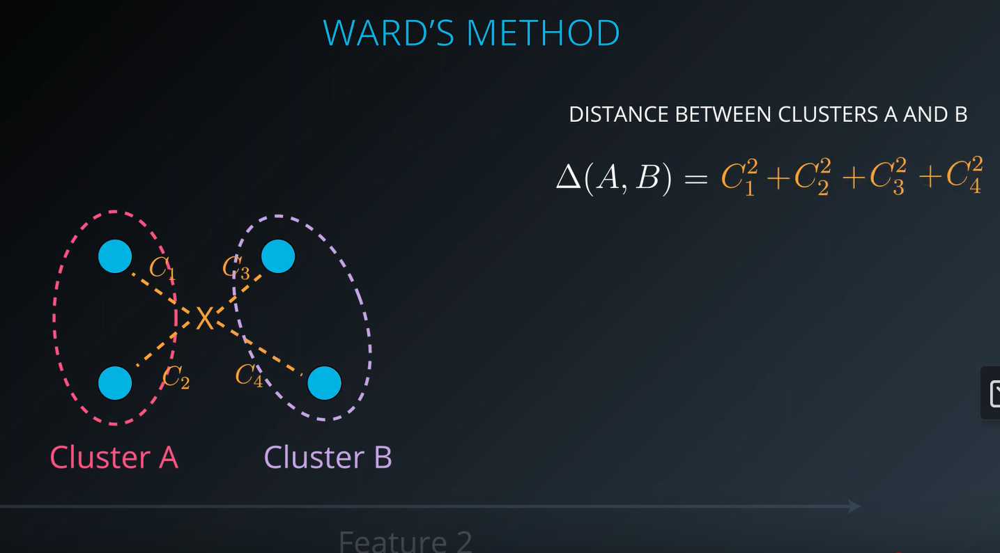

Whatever is smallest is then bridged into one cluster

### Hierarchical Clustering Implementation

It's pretty simple in python. To predict labels:

In [45]:
from sklearn import datasets, cluster
# load data
iris = datasets.load_iris()

# Spefify the parameters for the clustering. 
# 'ward' linkage is default. Can also use 'complete' or 'average'.
ward = cluster.AgglomerativeClustering(3, linkage='ward')
ward_pred = ward.fit_predict(iris.data)

avg = cluster.AgglomerativeClustering(3, linkage='average')
avg_pred = avg.fit_predict(iris.data)

complete = cluster.AgglomerativeClustering(3, linkage='complete')
complete_pred = complete.fit_predict(iris.data)

# '*_pred' now contains an array representing which cluster 
# each point belongs to:
# [1 0 0 0 1 2 0 1 0 0]

Then to plot it, you need to use scipy

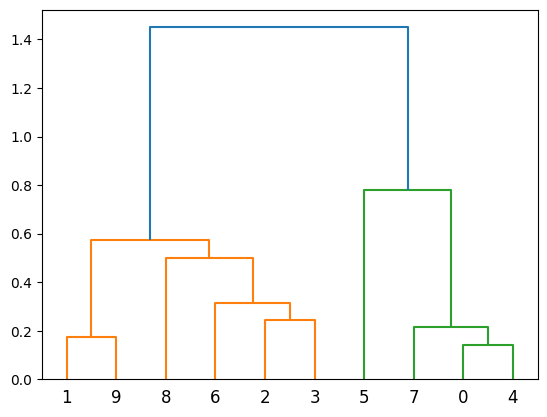

In [43]:
from scipy.cluster.hierarchy import dendrogram, ward, single
import matplotlib.pyplot as plt

# Perform clustering
linkage_matrix = ward(iris.data[:10])

# plot dendrogram
dendrogram(linkage_matrix)
plt.show()

We can calculate the adjusted Rand score (ARI) as well, which will allow us to see how similar different clustering assignments are. Ranges from -1 to 1, where 1 is perfect agreement, 0 is random clustering agreement, and negative suggests worse than random. We do this, basically to **see how close we made it to the target** with our prediction. Higher is better.

In [47]:
from sklearn.metrics import adjusted_rand_score

print(adjusted_rand_score(iris.target, ward_pred))
print(adjusted_rand_score(iris.target, avg_pred))  # highest
print(adjusted_rand_score(iris.target, complete_pred))

0.7311985567707746
0.7591987071071522
0.6422512518362898


What if we normalize the iris data?

In [48]:
from sklearn import preprocessing

normalized_iris = preprocessing.normalize(iris.data)
normalized_iris[:10]

array([[0.80377277, 0.55160877, 0.22064351, 0.0315205 ],
       [0.82813287, 0.50702013, 0.23660939, 0.03380134],
       [0.80533308, 0.54831188, 0.2227517 , 0.03426949],
       [0.80003025, 0.53915082, 0.26087943, 0.03478392],
       [0.790965  , 0.5694948 , 0.2214702 , 0.0316386 ],
       [0.78417499, 0.5663486 , 0.2468699 , 0.05808704],
       [0.78010936, 0.57660257, 0.23742459, 0.0508767 ],
       [0.80218492, 0.54548574, 0.24065548, 0.0320874 ],
       [0.80642366, 0.5315065 , 0.25658935, 0.03665562],
       [0.81803119, 0.51752994, 0.25041771, 0.01669451]])

In [49]:
ward = cluster.AgglomerativeClustering(3)
ward_pred = ward.fit_predict(normalized_iris)

complete = cluster.AgglomerativeClustering(3, linkage="complete")
complete_pred = complete.fit_predict(normalized_iris)

avg = cluster.AgglomerativeClustering(3, linkage="average")
avg_pred = avg.fit_predict(normalized_iris)


ward_ar_score = adjusted_rand_score(iris.target, ward_pred)
complete_ar_score = adjusted_rand_score(iris.target, complete_pred)
avg_ar_score = adjusted_rand_score(iris.target, avg_pred)

print( "Scores: \nWard:", ward_ar_score,"\nComplete: ", complete_ar_score, "\nAverage: ", avg_ar_score)

Scores: 
Ward: 0.8856970310281228 
Complete:  0.644447235392006 
Average:  0.5583714437541352


Wow, that made ward significantly more on target and the others much less so.

#### Advantages

- HC can be very informative
- Provides additional ability to visualize
- Great when dataset contains real hierarchical relationships

#### Disadvantages

- Sensitive to noise and outliers
- Computationally intensive $O(N^2)$

#### Applications

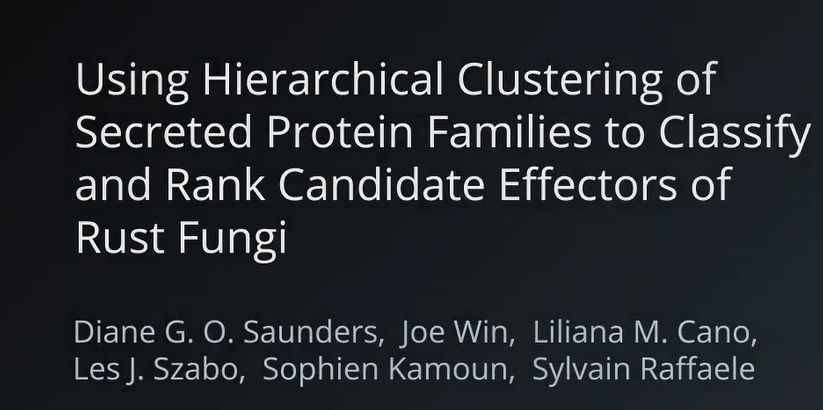

http://journals.plos.org/plosone/article?id=10.1371/journal.pone.0029847

### DBSCAN

Density-Based Spatial Clustering of Applications with Noise
- Groups points that are closely packed together
- Not every point is part of a cluster, which would mean it would get marked as noise

- Take a point, look at all neighbors within distance $\epsilon$ (epsilon), and if there are no neighbors, that point is a noise point. Otherwise, it is a cluster.
  - We can also have an input of the minimum number of inputs, (MinPts), which might in a certain case be 5.
  - If there are not the minimum amount of points, the reference point is noise (not the neighbors that are part of the \< 5 group.)


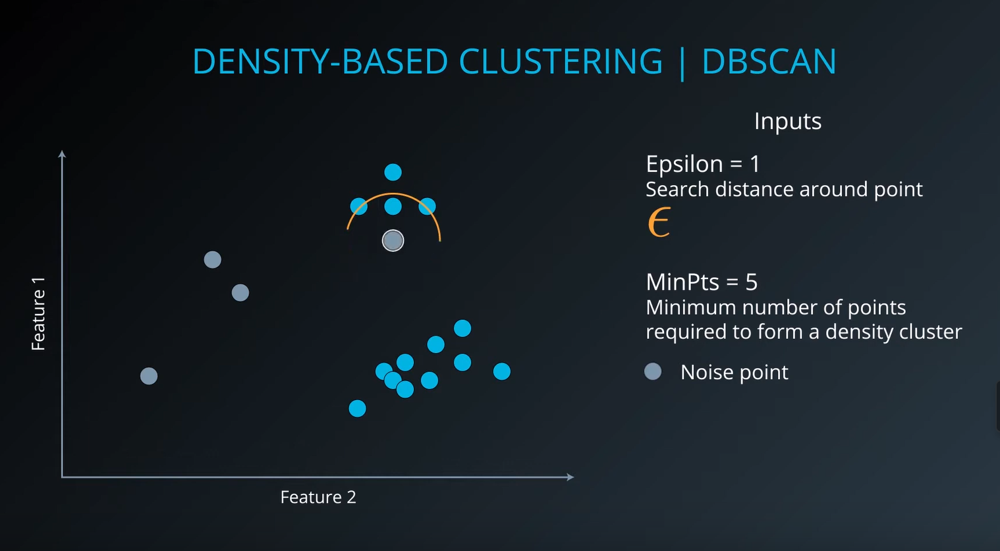

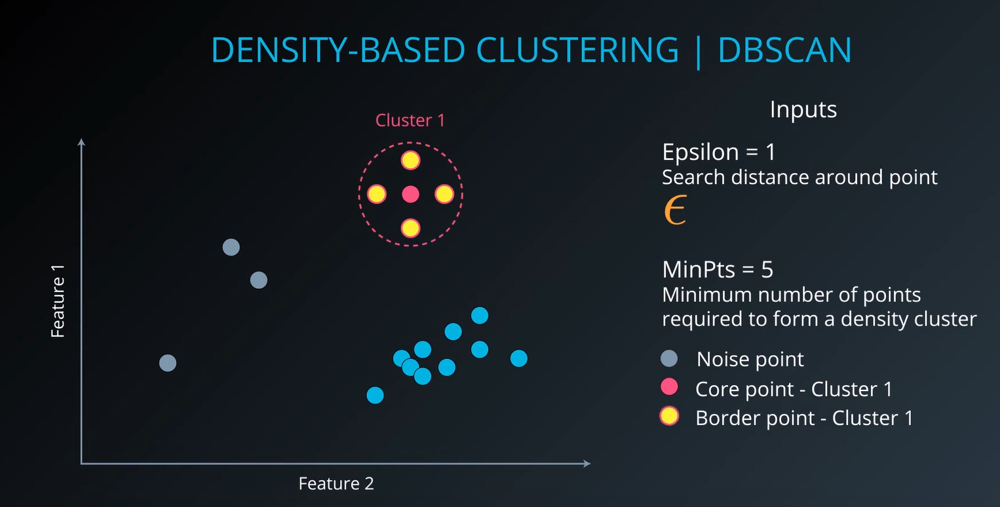

Core points are those that do have MinPts within $\epsilon$, while border points are points within that neighborly distance. Together, these make a cluster. There can be multiple core points in a cluster.

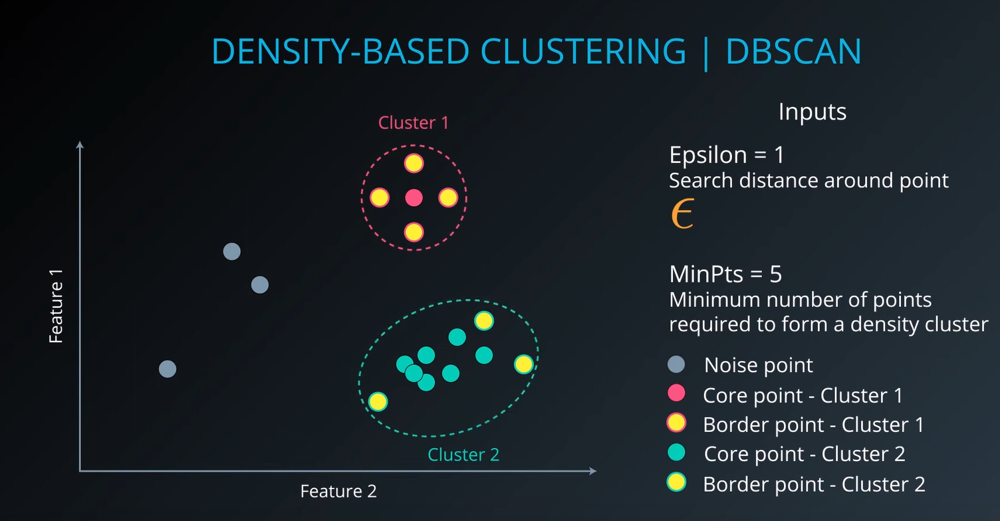




DBScan labels points that are densly packed and considers the rest to be noise.

#### Comparing to K-means

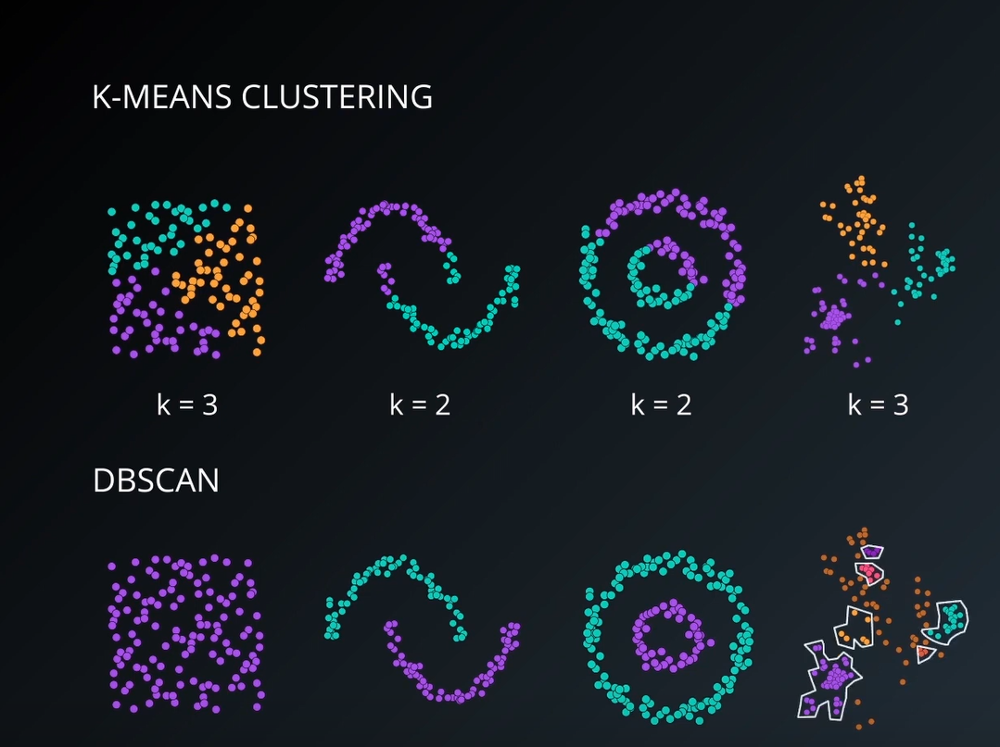

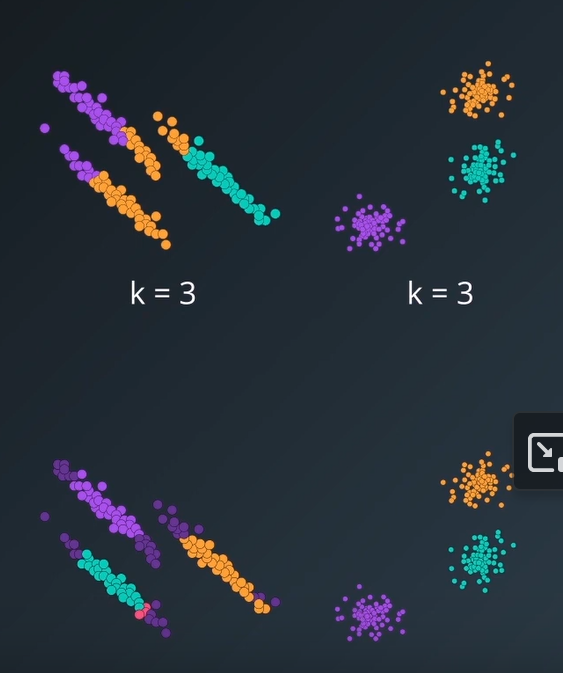

### DBSCAN Implementation

It's really easy.

In [50]:
from sklearn import datasets, cluster

# Load dataset
X = datasets.load_iris().data

# Specify the parameters for the clustering. There are the defaults.
db = cluster.DBSCAN(eps=0.5, min_samples=5)
db.fit(X)


# 'db.labels_' now contains an array representing which cluster each point belongs to. 
# Samples labeled '-1' are noise.

,eps,0.5
,min_samples,5
,metric,'euclidean'
,metric_params,None
,algorithm,'auto'
,leaf_size,30
,p,None
,n_jobs,None


In [62]:
import pandas as pd
dataset_1 = pd.read_csv('./datasets/blobs.csv')[:80].values

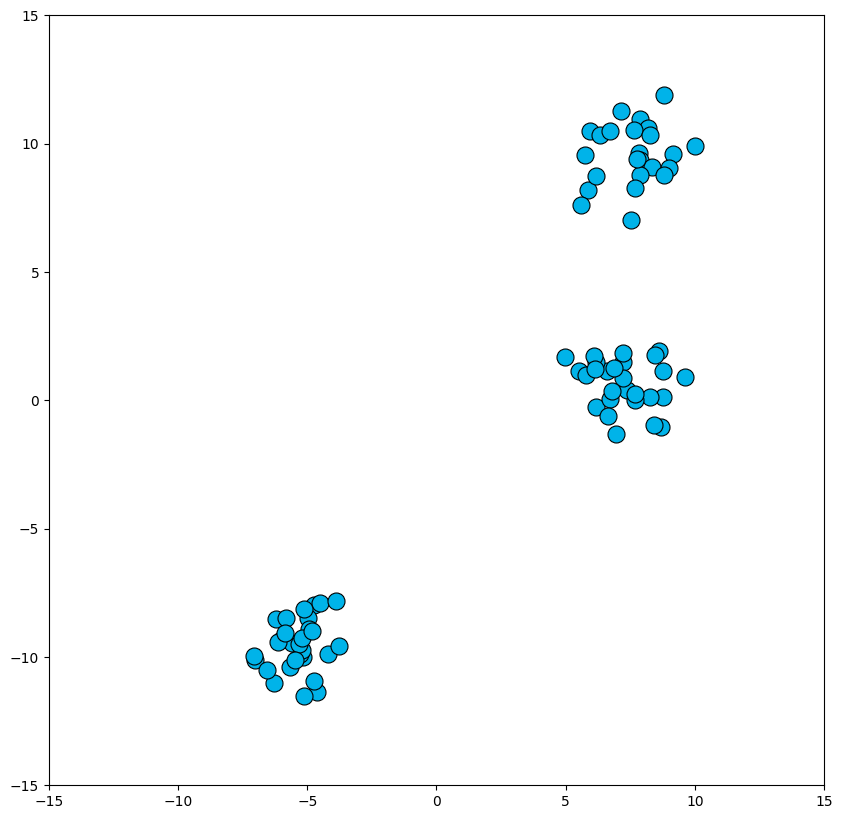

In [63]:
%matplotlib inline

import helpers.dbscan_lab_helper as helper
    
helper.plot_dataset(dataset_1)

Let's cluster it using DBSCAN's default settings and see what happens. We are hoping for it to be able to assign each of the three "blobs" into its own cluster. Can it do that out of the box?

In [66]:
#TODO: Import sklearn's cluster module
from sklearn import cluster

#TODO: create an instance of DBSCAN
dbscan = cluster.DBSCAN()
#TODO: use DBSCAN's fit_predict to return clustering labels for dataset_1
clustering_labels_1 = dbscan.fit_predict(dataset_1)

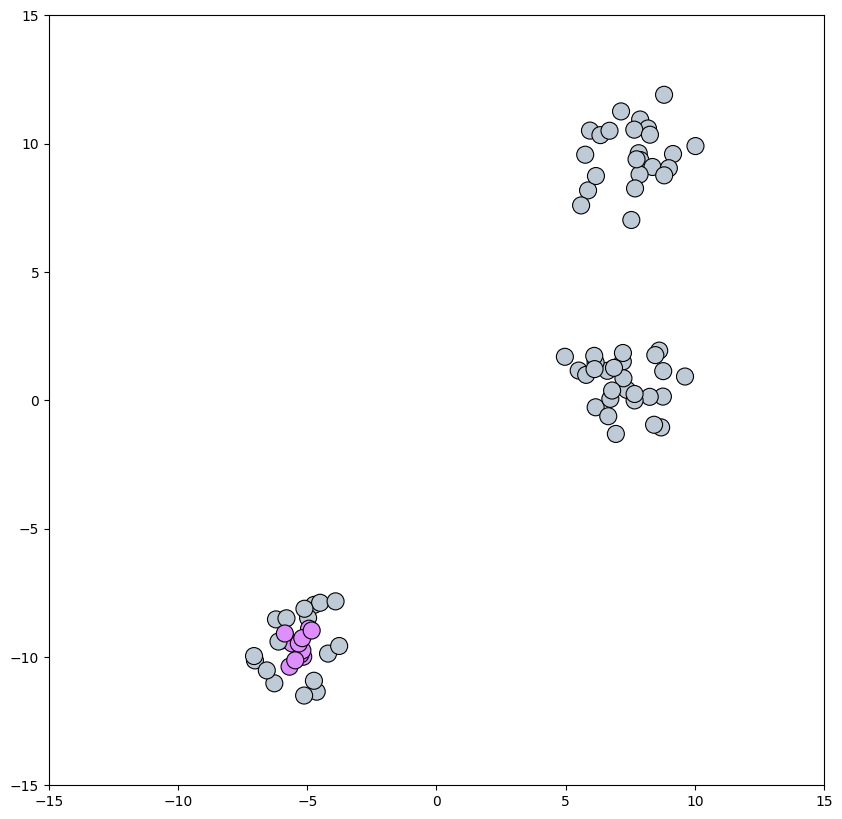

In [67]:
helper.plot_clustered_dataset(dataset_1, clustering_labels_1)

Oof. We can start by tweaking epsilon, which is defaulted to .5 in sklearn.

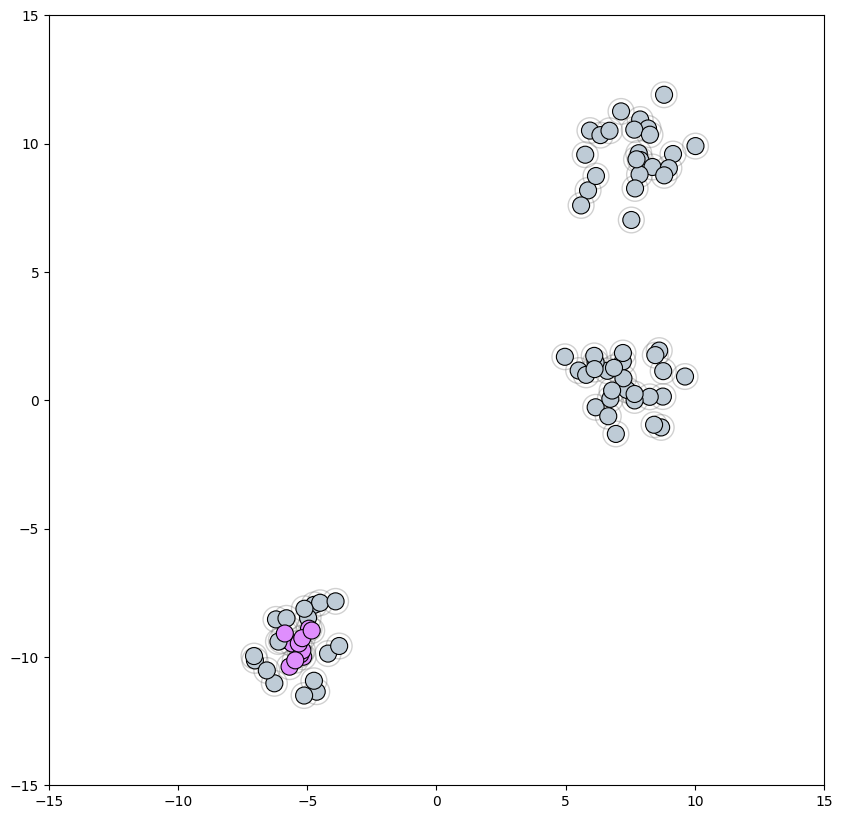

In [69]:
# This will draw the actual neighborhoods
helper.plot_clustered_dataset(dataset_1, clustering_labels_1, neighborhood=True)

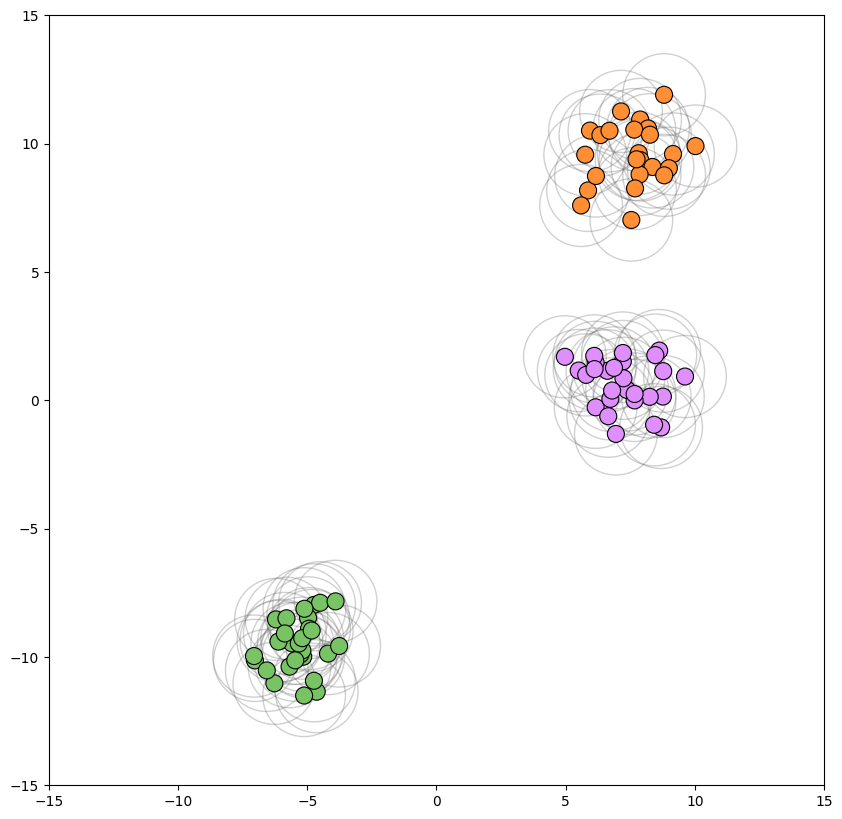

In [76]:
# TODO: increase the value of epsilon to allow DBSCAN to find three clusters in the dataset
epsilon=1.6

# Cluster
dbscan = cluster.DBSCAN(eps=epsilon)
clustering_labels_2 = dbscan.fit_predict(dataset_1)

# Plot
helper.plot_clustered_dataset(dataset_1, clustering_labels_2, neighborhood=True, epsilon=epsilon)

Now let's try something more complicated

In [78]:
dataset_2 = pd.read_csv('./datasets/varied.csv')[:300].values

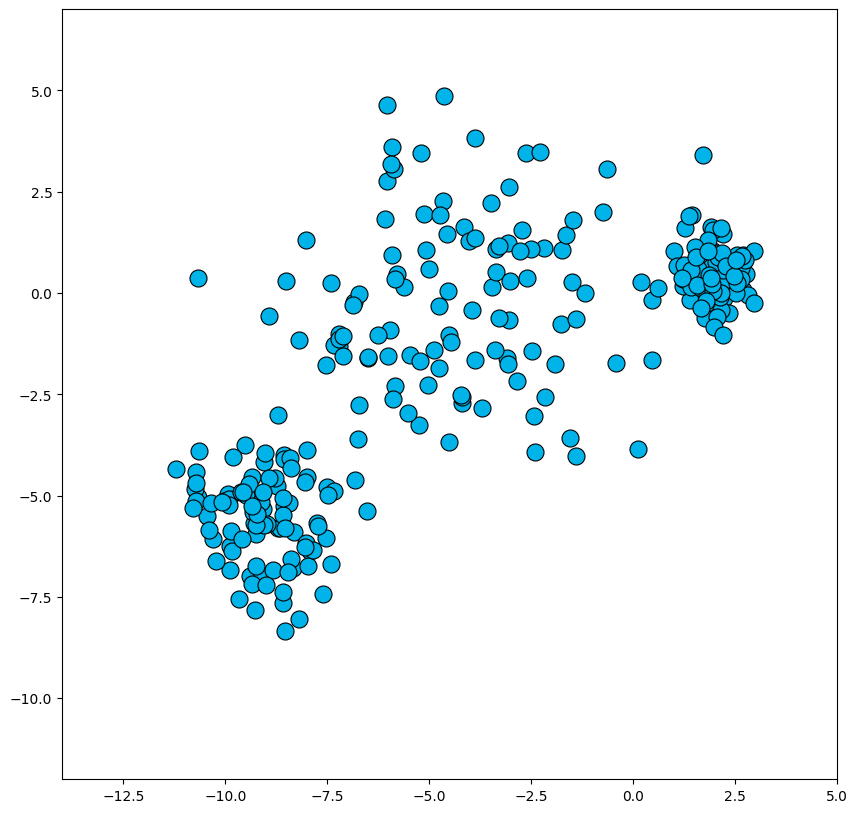

In [79]:
# Plot
helper.plot_dataset(dataset_2, xlim=(-14, 5), ylim=(-12, 7))

In [80]:
# Cluster with DBSCAN
# TODO: Create a new isntance of DBSCAN with default params
dbscan = cluster.DBSCAN()
# TODO: use DBSCAN's fit_predict to return clustering labels for dataset_2
clustering_labels_3 = dbscan.fit_predict(dataset_2)

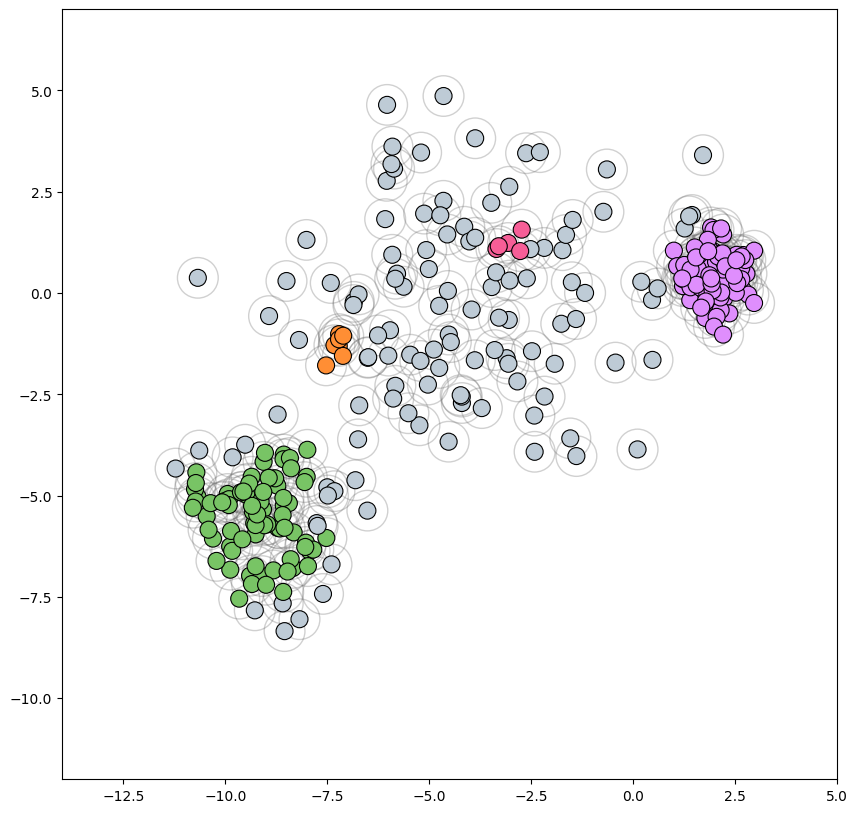

In [81]:
# Plot
helper.plot_clustered_dataset(dataset_2, 
                              clustering_labels_3, 
                              xlim=(-14, 5), 
                              ylim=(-12, 7), 
                              neighborhood=True, 
                              epsilon=0.5)

This clustering could make sense in some scenarios, but it seems rather arbitrary. Looking at the dataset, we can imagine at least two scenarios for what we'd want to do:
 * **Scenario** 1: Break the dataset up into three clusters: the blob on the left, the blob on the right, and the central area (even though it's less dense than the blobs on either side).
 * **Scenario 2**: Break the dataset up into two clusters: the blob on the left, and the blob on the right. Marking all the points in the center as noise. 
 
What values for the DBSCAN parameters would allow us to satisfy each of those senarios? Try a number of parameters to see if you can find a clustering that makes more sense.


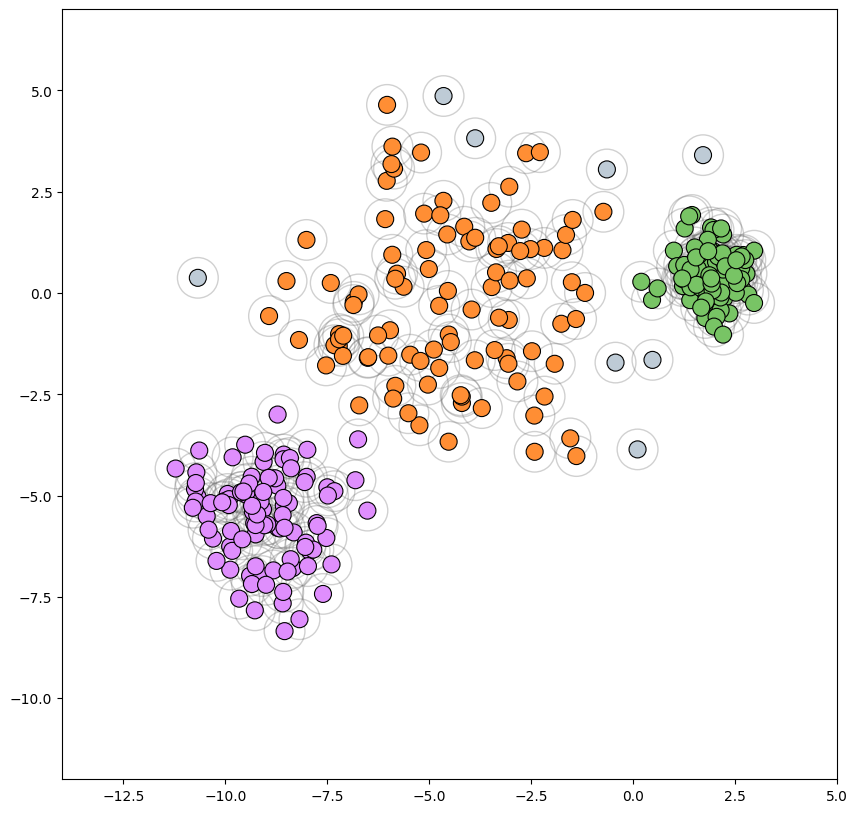

In [117]:
# Here are two clusters
eps=1.3
min_samples=5

# Cluster with DBSCAN
dbscan = cluster.DBSCAN(eps=eps, min_samples=min_samples)
clustering_labels_4 = dbscan.fit_predict(dataset_2)

# Plot
helper.plot_clustered_dataset(dataset_2, 
                              clustering_labels_4, 
                              xlim=(-14, 5), 
                              ylim=(-12, 7), 
                              neighborhood=True, 
                              epsilon=0.5)

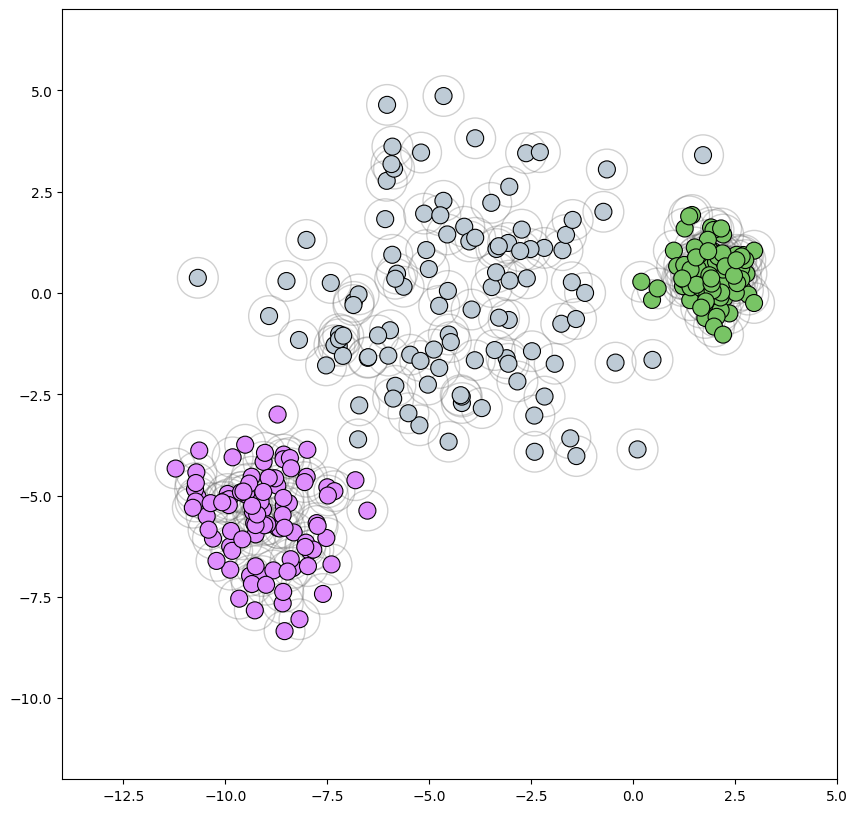

In [116]:
# Here are 3
eps=1.3
min_samples=20

# Cluster with DBSCAN
dbscan = cluster.DBSCAN(eps=eps, min_samples=min_samples)
clustering_labels_4 = dbscan.fit_predict(dataset_2)

# Plot
helper.plot_clustered_dataset(dataset_2, 
                              clustering_labels_4, 
                              xlim=(-14, 5), 
                              ylim=(-12, 7), 
                              neighborhood=True, 
                              epsilon=0.5)

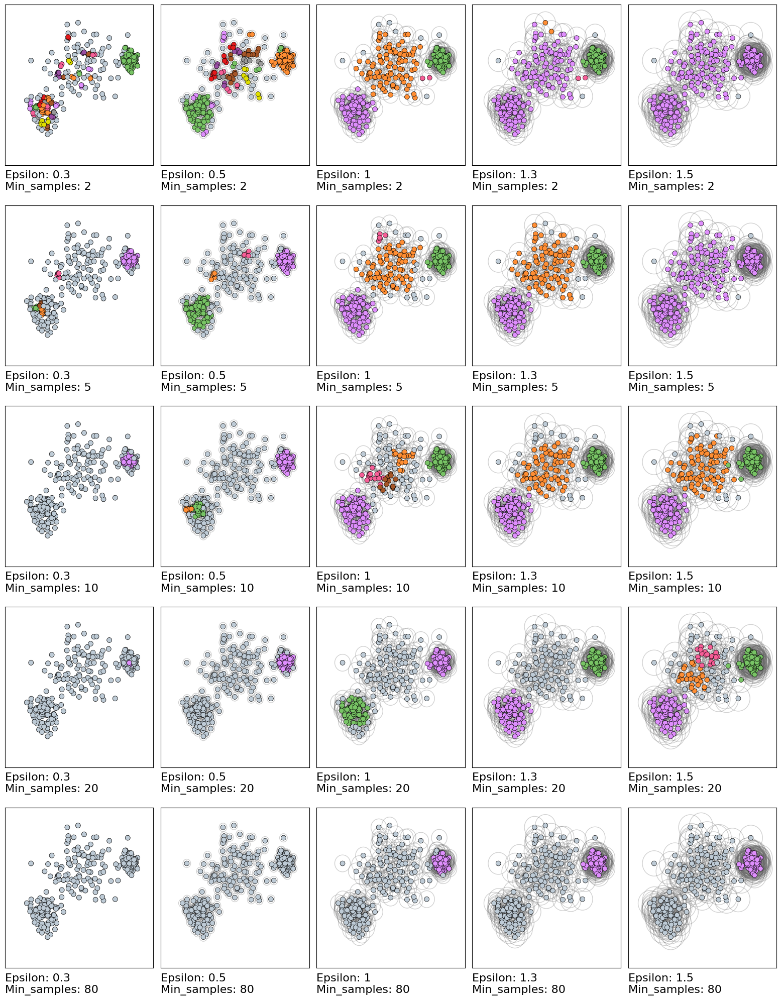

In [115]:
eps_values = [0.3, 0.5, 1, 1.3, 1.5]
min_samples_values = [2, 5, 10, 20, 80]

helper.plot_dbscan_grid(dataset_2, eps_values, min_samples_values)


#### Advantages

- No need to specify number of clusters
- Flexible in the shape and size of clusters
- Handles noise and outliers

#### Disadvantages

- Border points that are reachable from 2 clusters are assigned to the clustre that "finds" it first, so it's not guaranteed that clustering will always be the same.
- It has difficulty finding clusters of varying density.

Uses: 
- https://conferences.sigcomm.org/sigcomm/2006/papers/minenet-01.pdf - network traffic classification

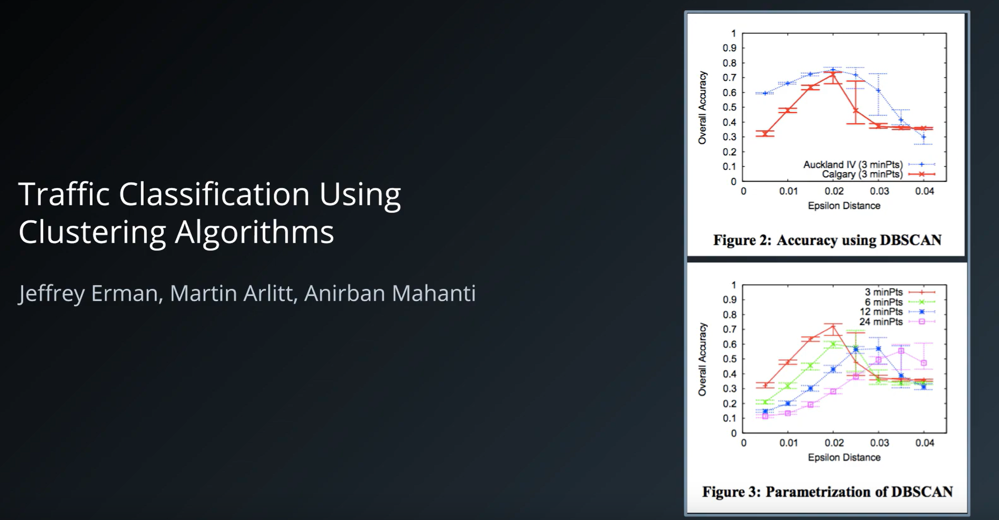

- https://ieeexplore.ieee.org/abstract/document/5946052/ - Anomaly detection

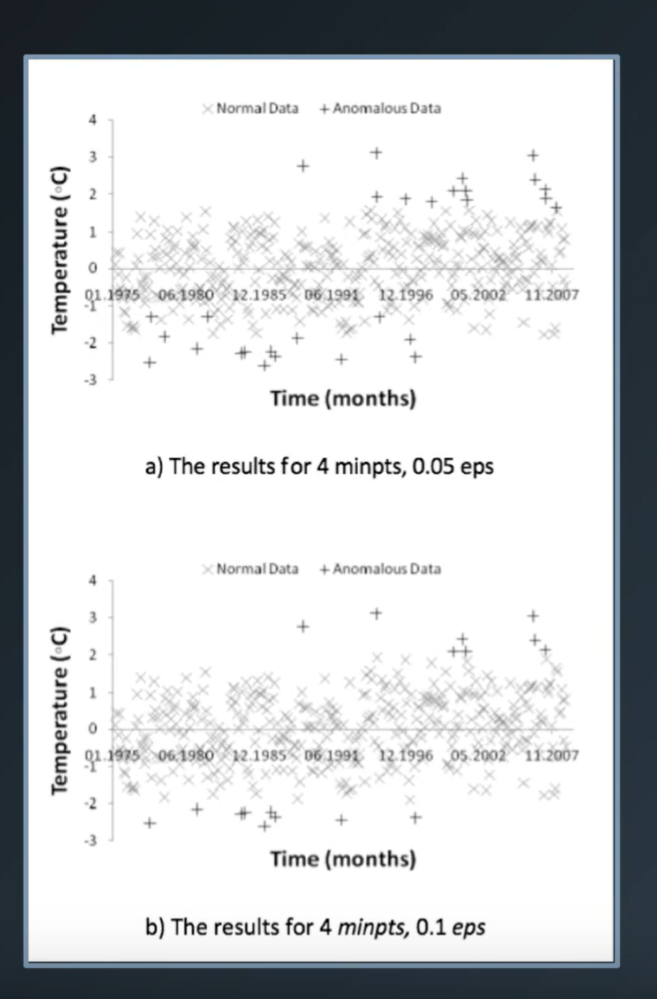

## Gaussian Mixture Models and Cluster Validation

### Gaussian mixture models

### Cluster Validation

## Dimensionality Reduction

Essentially reducing the number of variables used.

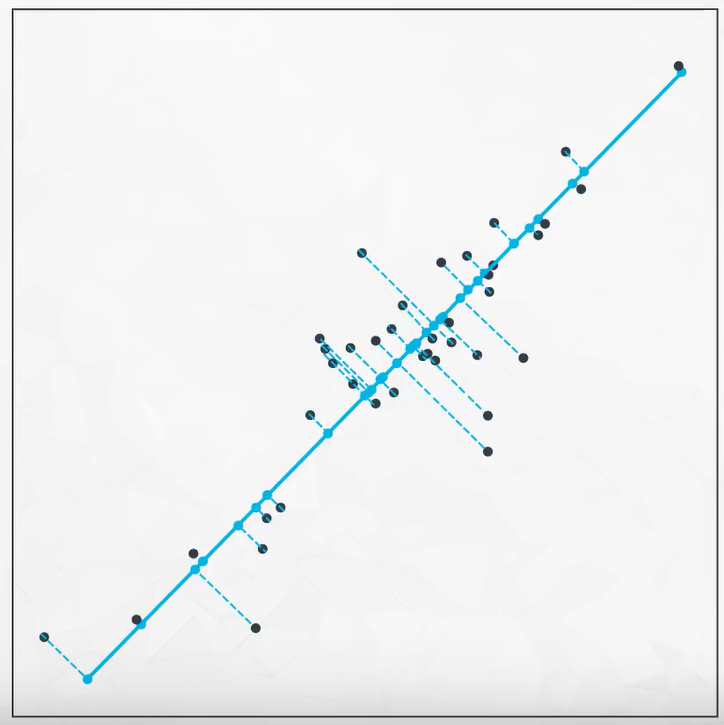

